In [1]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.animation as animation
import pandas as pd

from scipy import ndimage

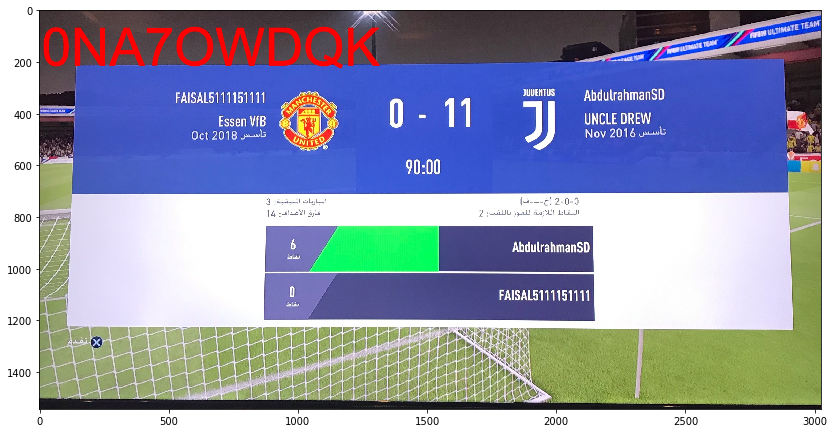

In [3]:
img = cv2.imread('images/fifa.jpg')
plt.figure(figsize=(14,8))
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))

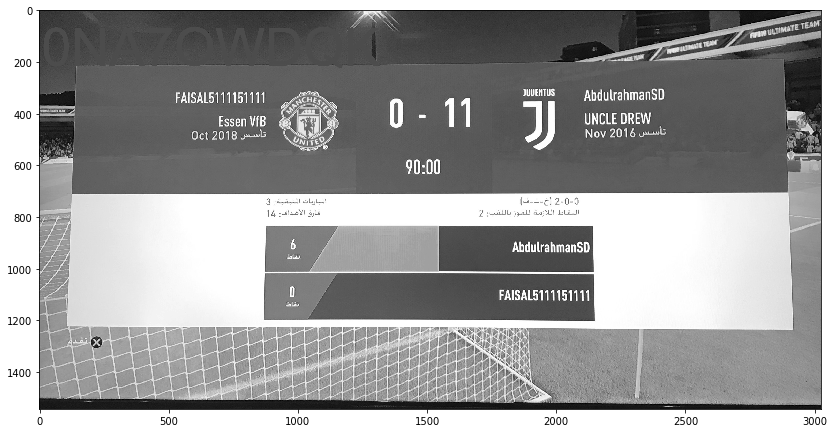

In [4]:
plt.figure(figsize=(14,8))
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
plt.imshow(gray,cmap='gray')

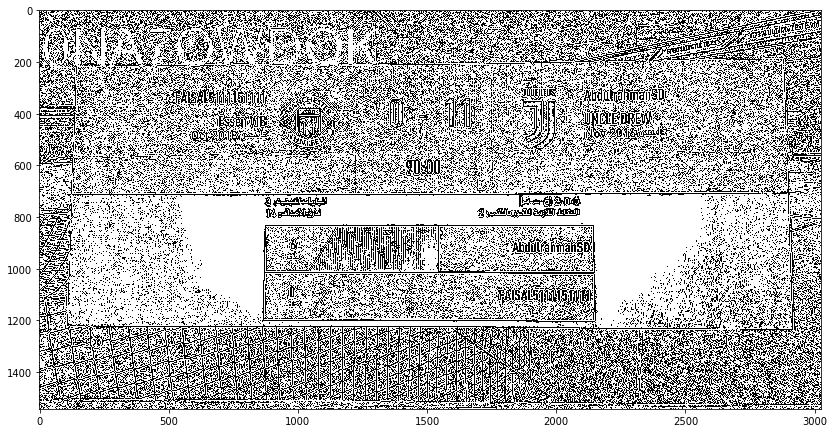

In [4]:
thresh=cv2.adaptiveThreshold(gray, 200, adaptiveMethod=cv2.ADAPTIVE_THRESH_GAUSSIAN_C, thresholdType=cv2.THRESH_BINARY_INV, blockSize=9, C=0)
plt.figure(figsize=(14,8))
plt.imshow(thresh, cmap='gray')

In [5]:
contours, hierarchy = cv2.findContours(thresh, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
cnts = sorted(contours, key = cv2.contourArea, reverse = True)[:20]
# loop over our contours
final_contours = []
for c in cnts:
	# approximate the contour
	peri = cv2.arcLength(c, True)
	approx = cv2.approxPolyDP(c, 0.015 * peri, True)
 
	# if our approximated contour has four points, then
	# we can assume that we have found our screen
	if len(approx) == 4:
		final_contours.append(approx)
print(f'Number of contours: {len(final_contours)}')

Number of contours: 6


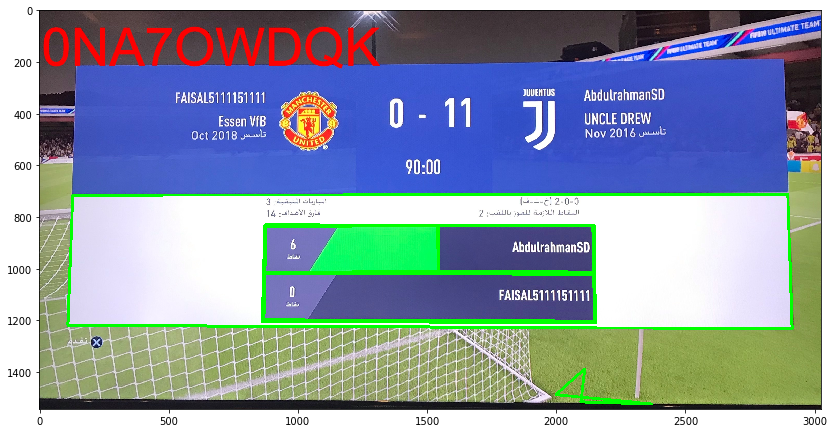

In [6]:
img_ed=img.copy()
for i in range(len(final_contours)):
    cnt = final_contours[i]
    cv2.drawContours(img_ed, [cnt], 0, (0,255,0), 10)
plt.figure(figsize=(14,8))
plt.imshow(cv2.cvtColor(img_ed, cv2.COLOR_BGR2RGB))

In [5]:
#200
def detect_contour_bottom(gray, im_show=True, raw_img = img):
    thresh=cv2.adaptiveThreshold(gray, 200, adaptiveMethod=cv2.ADAPTIVE_THRESH_GAUSSIAN_C, thresholdType=cv2.THRESH_BINARY_INV, blockSize=9, C=0)
    contours, hierarchy = cv2.findContours(thresh, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    cnts = sorted(contours, key = cv2.contourArea, reverse = True)[:20]
    # loop over our contours
    final_contours = []
    for c in cnts:
        # approximate the contour
        peri = cv2.arcLength(c, True)
        approx = cv2.approxPolyDP(c, 0.015 * peri, True)

        # if our approximated contour has four points, then
        # we can assume that we have found our screen
        if len(approx) == 4:
            final_contours.append(approx)
    print(f'Number of contours: {len(final_contours)}')
    
   
    img_ed=raw_img.copy()
    for i in range(len(final_contours)):
        cnt = final_contours[i]
        cv2.drawContours(img_ed, [cnt], 0, (0,255,0), 10)
    if im_show:
        plt.figure(figsize=(14,8))
        plt.imshow(cv2.cvtColor(img_ed, cv2.COLOR_BGR2RGB))
        
    return final_contours,img_ed
    

Number of contours: 2


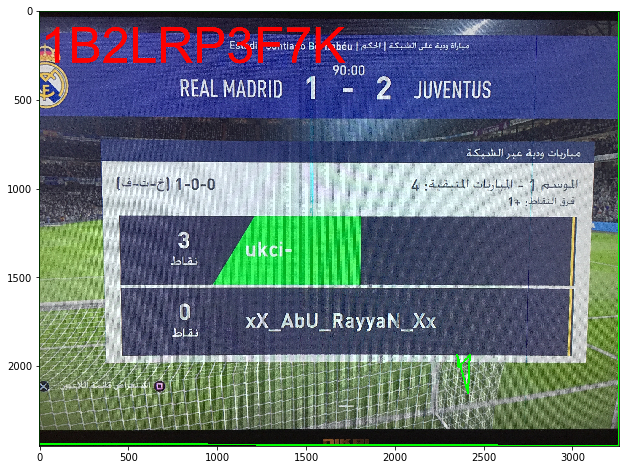

In [46]:
final_contours, _  = detect_contour_bottom(gray, im_show=True, raw_img = img)

In [9]:
#c = np.array([[215,263],[790,407]])
cv2.contourArea(final_contours[0])

1423509.0

In [6]:
def rect_area(c):
    return (c[1][0] - c[0][0])*(c[1][1] - c[0][1])

def coutour2rect(c):
    c=c.reshape(4,2)
    x1,y1 = (np.min(c[:,0]), np.min(c[:,1]))
    x2,y2 = (np.max(c[:,0]), np.max(c[:,1]))
    return np.array([[x1,y1],[x2,y2]])       

In [11]:
# region of interest
roi = np.array([[125,712],[2913,1236]])
roi[0][0]

125

In [7]:
matches_map = {'0NA7OWDQK.jpg': {'top': [[141,213],[2899,701]],
                                 'bottom': [[125,712],[2913,1236]]
                                 },
               '0CAUQSQDG0.jpg': {'top': [[1,1544],[2913,1924]],
                                  'bottom': [[289,2008],[2461,3028]]
                                 },
               '0DF1AA42B9.jpg': {'top': [[64,33],[1062,153]],
                                  'bottom': [[203,184],[927,520]]
                                 },
               '0G1UJLATWE.jpg': {'top': [[49,113],[3233,517]],
                                  'bottom': [[549,633],[3264,2286]]
                                 },
               '0I6P2YFPAU.jpg': {'top': [[1,1],[4029,637]],
                                  'bottom': [[205,797],[4029,2461]]
                                 },
               '0OAAZRH8NU.jpg': {'top': [[441,21],[3613,377]],
                                  'bottom': [[885,505],[3181,1537]]
                                 },
               '0QNHKHHEZ0.jpg': {'top': [[39,477],[707,559]],
                                  'bottom': [[135,599],[615,801]]
                                 },
               '1B2LRP3F7K.jpg': {'top': [[5,113],[3257,605]],
                                  'bottom': [[345,717],[3077,1973]]
                                 },
               '1BD5PXLNTK.jpg': {'top': [[1,819],[4021,999]],
                                  'bottom': [[297,1375],[3761,2743]]
                                 },
                '1F28E63C50.jpg': {'top': [[73,489],[4025,1061]],
                                  'bottom': [[605,1125],[3657,2629]]
                                 }
               
              }

In [8]:
import glob

In [9]:
path = 'images\\screen_matches\\'
files = glob.glob(path+'*.jpg')
print(files)

['images\\screen_matches\\0CAUQSQDG0.jpg', 'images\\screen_matches\\0DF1AA42B9.jpg', 'images\\screen_matches\\0G1UJLATWE.jpg', 'images\\screen_matches\\0I6P2YFPAU.jpg', 'images\\screen_matches\\0NA7OWDQK.jpg', 'images\\screen_matches\\0OAAZRH8NU.jpg', 'images\\screen_matches\\0QNHKHHEZ0.jpg', 'images\\screen_matches\\1B2LRP3F7K.jpg', 'images\\screen_matches\\1BD5PXLNTK.jpg', 'images\\screen_matches\\1F28E63C50.jpg']


In [10]:
#x=matches_map[f_name]['bottom']
def draw_rect(x,img,color=(255, 0, 0)):
    pt1=tuple(x[0])
    pt2=tuple(x[1])
    img_rect = cv2.rectangle(img, pt1,pt2,color , 5)

In [11]:
def bb_intersection_over_union(boxA, boxB):
	# determine the (x, y)-coordinates of the intersection rectangle
	xA = max(boxA[0], boxB[0])
	yA = max(boxA[1], boxB[1])
	xB = min(boxA[2], boxB[2])
	yB = min(boxA[3], boxB[3])
 
	# compute the area of intersection rectangle
	interArea = max(0, xB - xA + 1) * max(0, yB - yA + 1)
 
	# compute the area of both the prediction and ground-truth
	# rectangles
	boxAArea = (boxA[2] - boxA[0] + 1) * (boxA[3] - boxA[1] + 1)
	boxBArea = (boxB[2] - boxB[0] + 1) * (boxB[3] - boxB[1] + 1)
 
	# compute the intersection over union by taking the intersection
	# area and dividing it by the sum of prediction + ground-truth
	# areas - the interesection area
	iou = interArea / float(boxAArea + boxBArea - interArea)
 
	# return the intersection over union value
	return iou

Number of contours: 1
file: 0CAUQSQDG0.jpg
iou: 0.3053096208340902
Number of contours: 1
file: 0DF1AA42B9.jpg
iou: 0.016317150942765344
Number of contours: 2
file: 0G1UJLATWE.jpg
iou: 0.6011212620412911
Number of contours: 2
file: 0I6P2YFPAU.jpg
iou: 0.777684783056395
Number of contours: 6
file: 0NA7OWDQK.jpg
iou: 0.9871078796807924
Number of contours: 5
file: 0OAAZRH8NU.jpg
iou: 0.9099966982524113
Number of contours: 3
file: 0QNHKHHEZ0.jpg
iou: 0.0
Number of contours: 2
file: 1B2LRP3F7K.jpg
iou: 0.4299454386534025
Number of contours: 0
Detection fail
file: 1BD5PXLNTK.jpg
iou: 0
Number of contours: 2
file: 1F28E63C50.jpg
iou: 0.3326513978408036


{'0CAUQSQDG0.jpg': 0.3053096208340902,
 '0DF1AA42B9.jpg': 0.016317150942765344,
 '0G1UJLATWE.jpg': 0.6011212620412911,
 '0I6P2YFPAU.jpg': 0.777684783056395,
 '0NA7OWDQK.jpg': 0.9871078796807924,
 '0OAAZRH8NU.jpg': 0.9099966982524113,
 '0QNHKHHEZ0.jpg': 0.0,
 '1B2LRP3F7K.jpg': 0.4299454386534025,
 '1BD5PXLNTK.jpg': 0,
 '1F28E63C50.jpg': 0.3326513978408036}

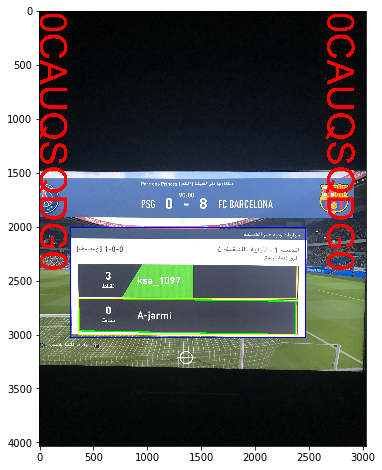

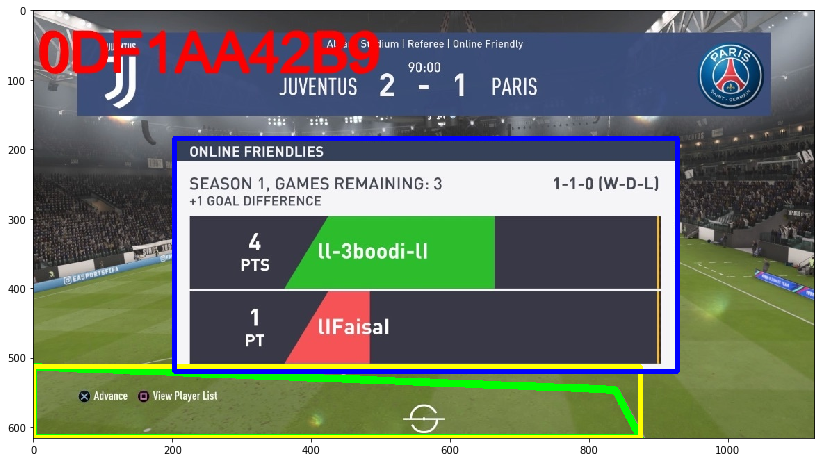

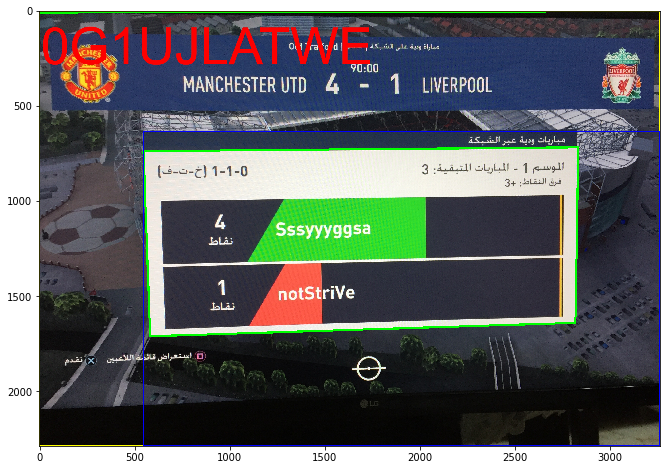

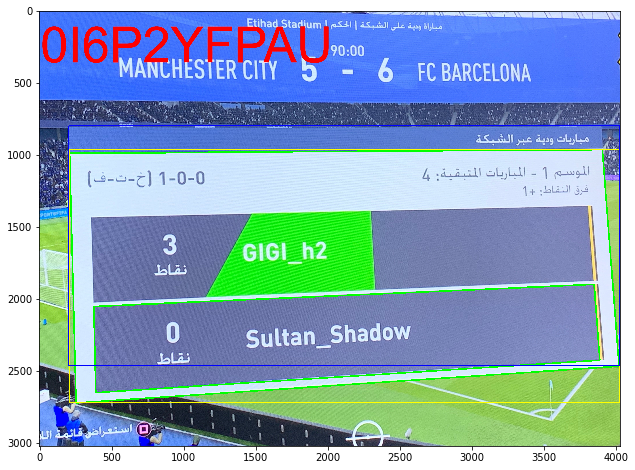

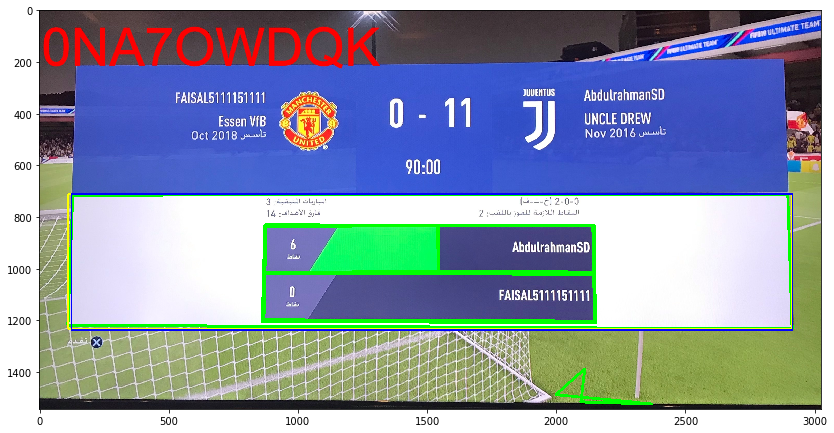

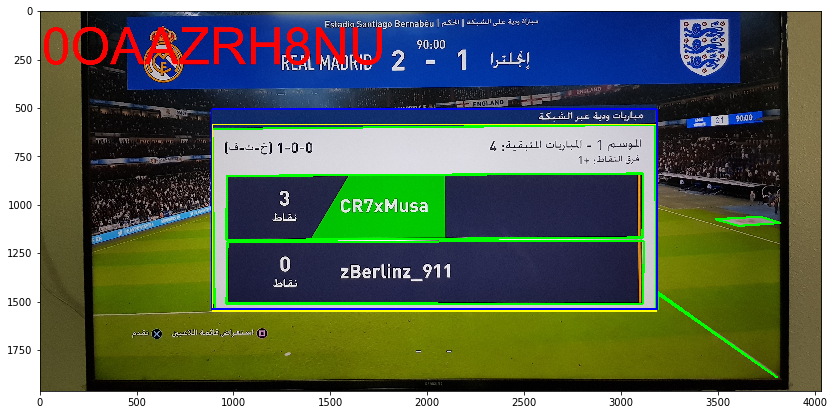

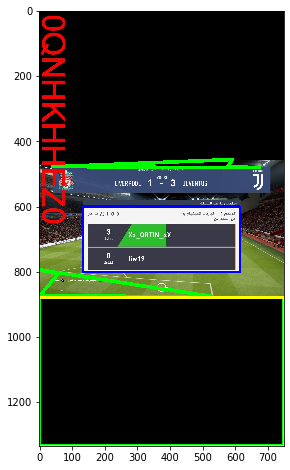

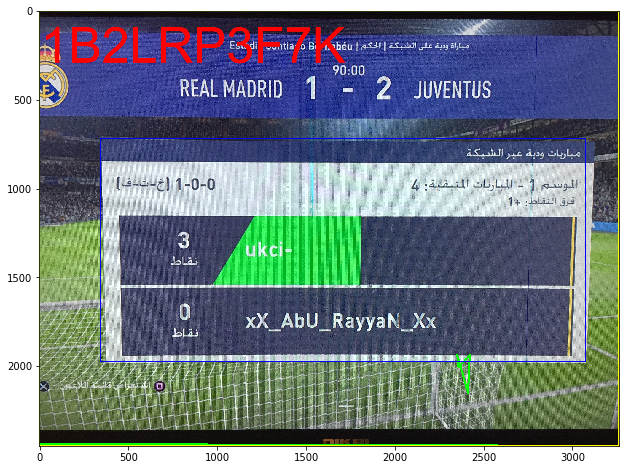

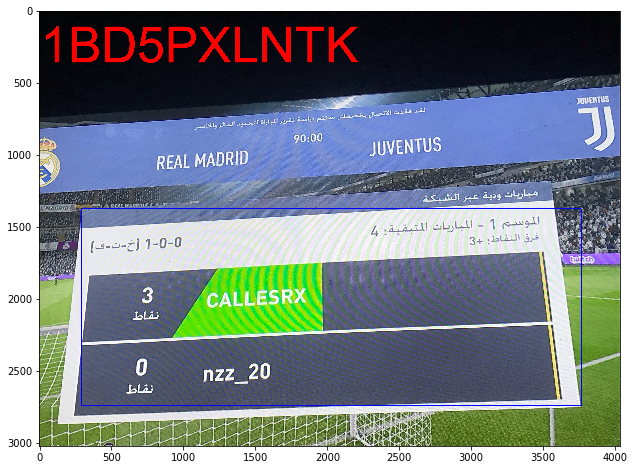

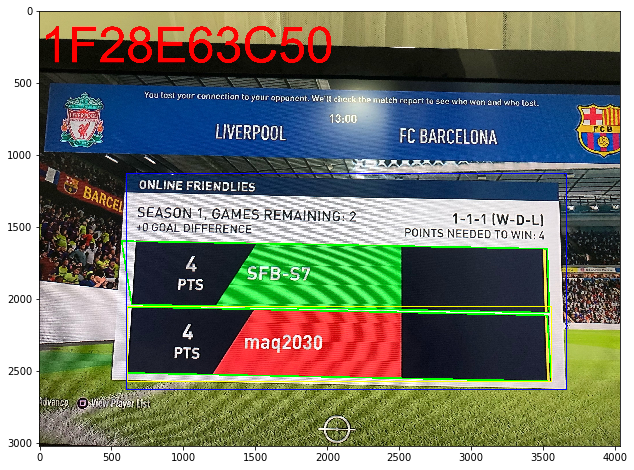

In [47]:
D={}
for f in files:
    img = cv2.imread(f)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    f_name = f.split('\\')[-1]
    final_contours, img_ed = detect_contour_bottom(gray, im_show=False, raw_img = img)
    if len(final_contours)>0:
        #acc = iou(final_contours[0],np.array(matches_map[f_name]['bottom']))
        boxA=coutour2rect(final_contours[0]).ravel()
        boxB=np.array(matches_map[f_name]['bottom']).ravel()
        acc = bb_intersection_over_union(boxA, boxB)
        draw_rect(coutour2rect(final_contours[0]),img_ed,(0,255,255))
        
    else:
        print('Detection fail')
        acc=0
    print(f'file: {f_name}')
    print(f'iou: {acc}')
    D[f_name]=acc
    draw_rect(matches_map[f_name]['bottom'],img_ed)
    
    plt.figure(figsize=(14,8))
    plt.imshow(cv2.cvtColor(img_ed, cv2.COLOR_BGR2RGB))
D

In [18]:
D

{'0CAUQSQDG0.jpg': 0.3053096208340902,
 '0DF1AA42B9.jpg': 0.016317150942765344,
 '0G1UJLATWE.jpg': 0.6011212620412911,
 '0I6P2YFPAU.jpg': 0.777684783056395,
 '0NA7OWDQK.jpg': 0.9871078796807924,
 '0OAAZRH8NU.jpg': 0.9099966982524113,
 '0QNHKHHEZ0.jpg': 0.0,
 '1B2LRP3F7K.jpg': 0.4299454386534025,
 '1BD5PXLNTK.jpg': 0,
 '1F28E63C50.jpg': 0.3326513978408036}

In [19]:
print(f'Accuracy: {(len([i for i in D if D[i]>0.5])/len(D.keys()))*100}')

Accuracy: 40.0


## Haar Cascades

In [20]:
box_cascade = cv2.CascadeClassifier('data/cascade.xml')

boxes: [[ 26  42 130  60]]
boxes: [[ 23  30 111  51]]
boxes: [[ 25  22 106  49]]
boxes: [[ 38  27 118  55]]
boxes: [[ 46  40 107  49]
 [  7  38 105  48]]
boxes: ()
boxes: [[ 36  47 113  52]]
boxes: [[ 65  27 115  53]]
boxes: [[ 46   5 134  62]
 [ 44  40 111  51]]
boxes: ()


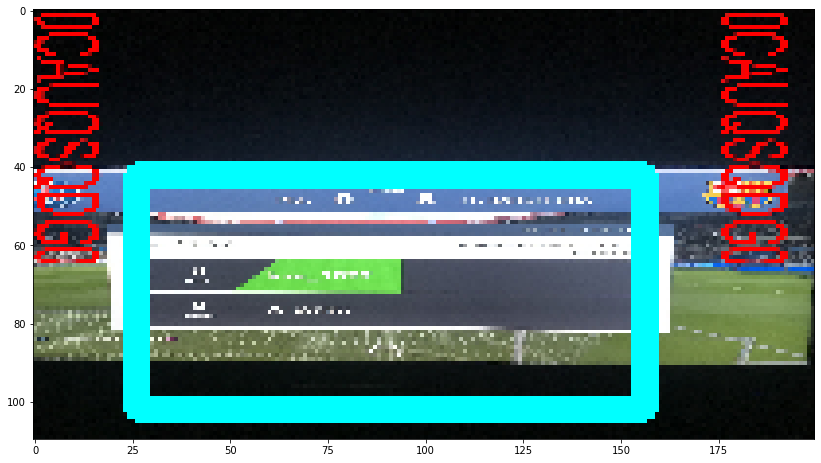

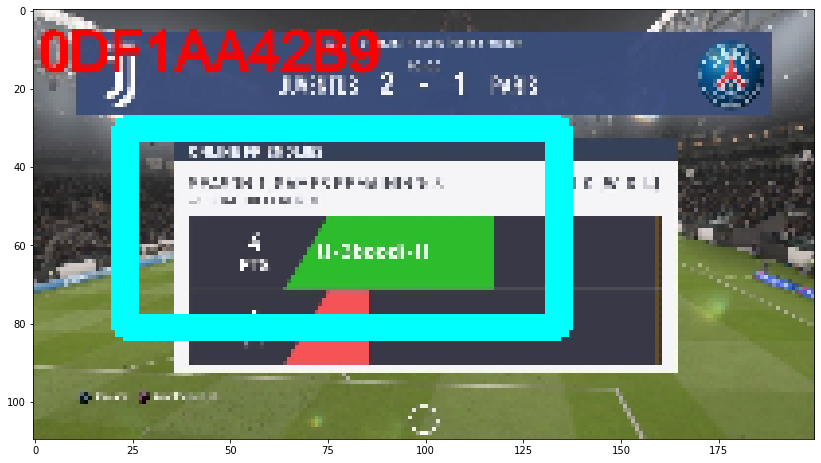

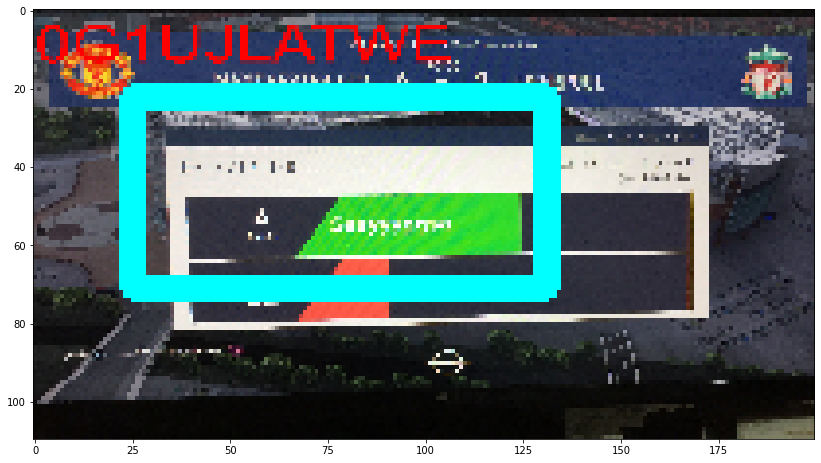

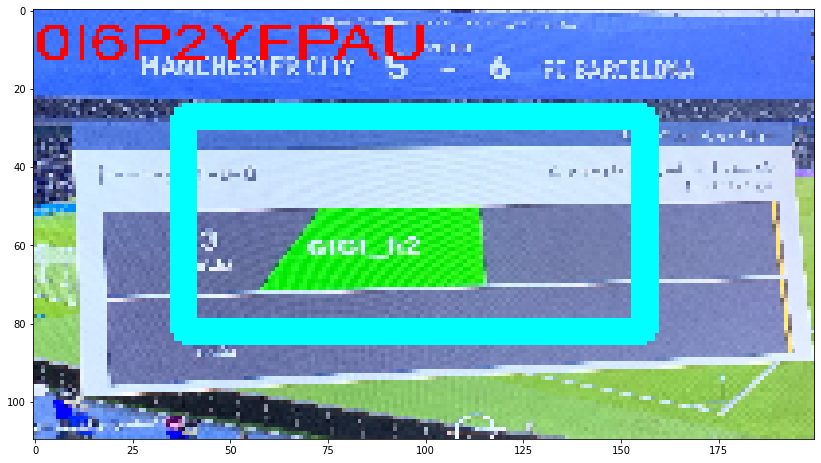

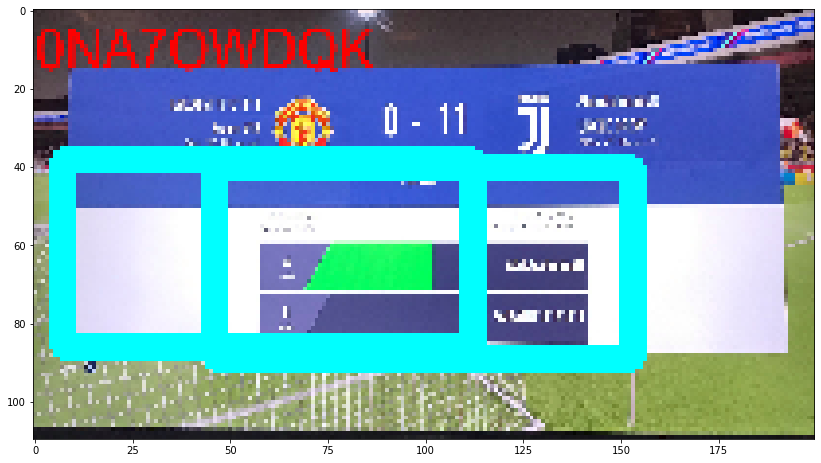

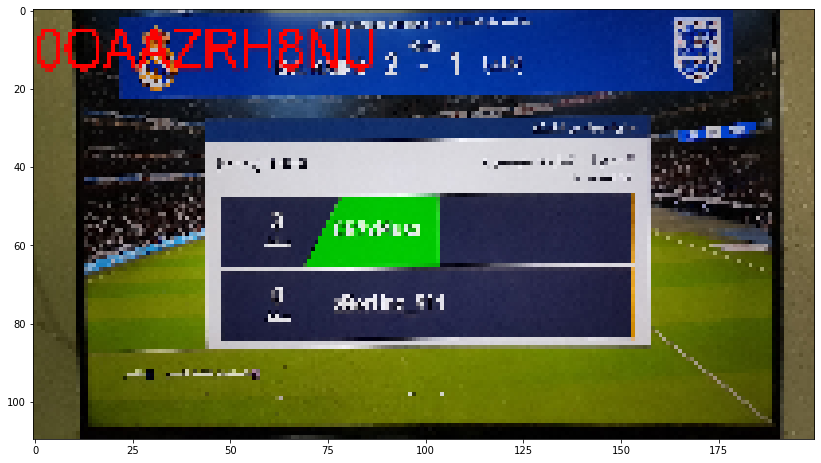

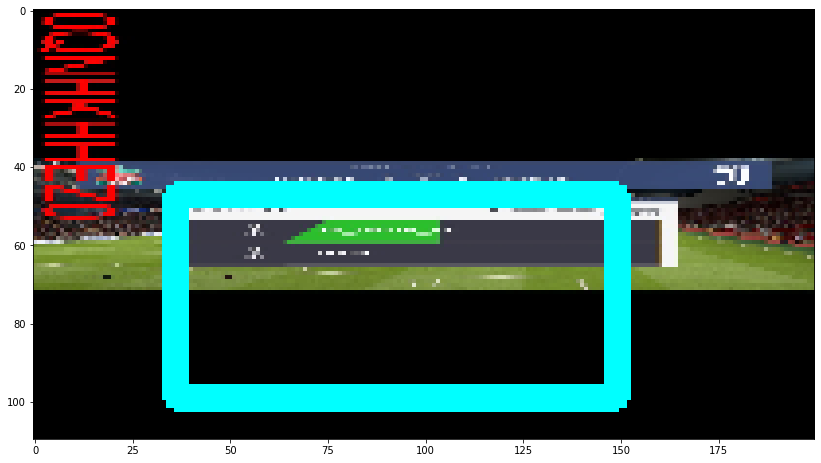

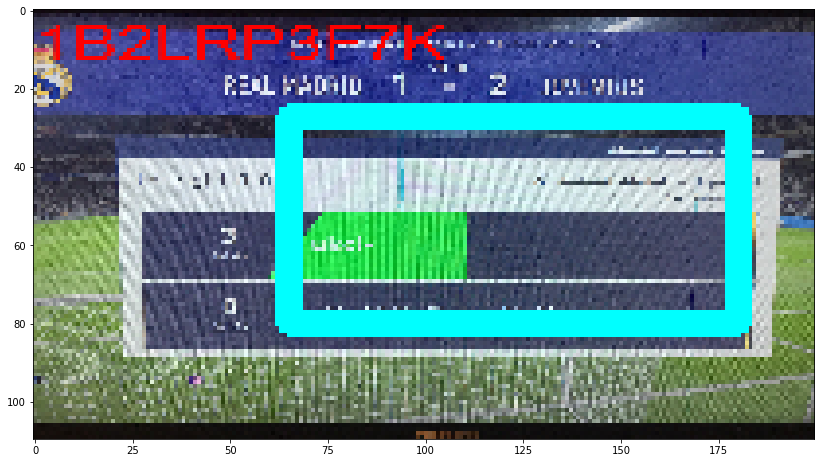

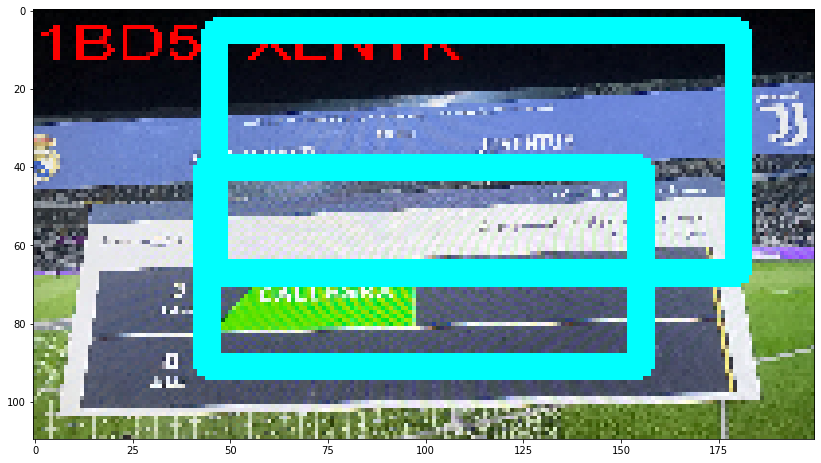

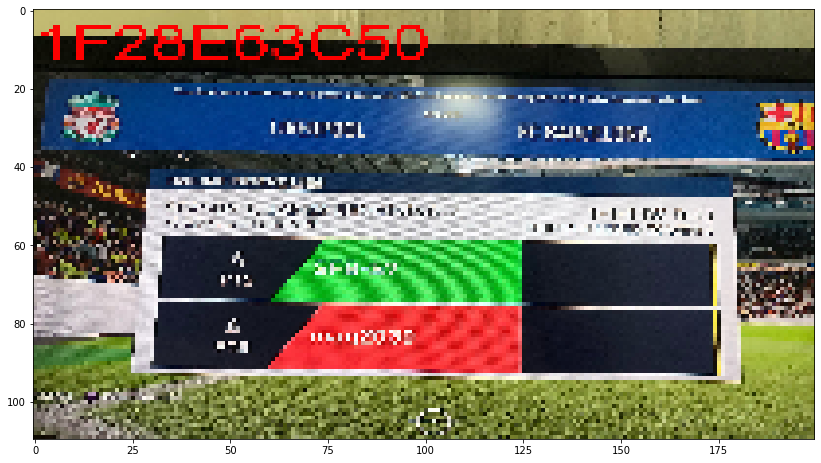

In [34]:
D_haar={}
for f in files:
    img = cv2.imread(f)
    img = cv2.resize(img, (200,110))
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    f_name = f.split('\\')[-1]
    
    #
    
    boxes = box_cascade.detectMultiScale(gray )
    print(f'boxes: {boxes}')
    for (x,y,w,h) in boxes:
        cv2.rectangle(img,(x,y),(x+w,y+h),(255,255,0),5)
    plt.figure(figsize=(14,8))    
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    
    
    
    
#     final_contours, img_ed = detect_contour_bottom(gray, im_show=False, raw_img = img)
#     if len(final_contours)>0:
#         #acc = iou(final_contours[0],np.array(matches_map[f_name]['bottom']))
#         boxA=coutour2rect(final_contours[0]).ravel()
#         boxB=np.array(matches_map[f_name]['bottom']).ravel()
#         acc = bb_intersection_over_union(boxA, boxB)
#         draw_rect(coutour2rect(final_contours[0]),img_ed,(0,255,255))
        
#     else:
#         print('Detection fail')
#         acc=0
#     print(f'file: {f_name}')
#     print(f'iou: {acc}')
#     D[f_name]=acc
#     draw_rect(matches_map[f_name]['bottom'],img_ed)
    
#     plt.figure(figsize=(14,8))
#     plt.imshow(cv2.cvtColor(img_ed, cv2.COLOR_BGR2RGB))
# D

## Line detectiong and rotating

avr_degree: -44.98323543729074
Number of contours: 4
file: 0CAUQSQDG0.jpg
iou: 0.0891192286356638
avr_degree: -0.07055702156459286
Number of contours: 4
file: 0DF1AA42B9.jpg
iou: 0.2896551724137931
avr_degree: 44.37882187901022
Number of contours: 5
file: 0G1UJLATWE.jpg
iou: 0.29167431736508126
avr_degree: 44.99780656004527
Number of contours: 2
file: 0I6P2YFPAU.jpg
iou: 0.25617758604960317
avr_degree: 1.2560332966383743
Number of contours: 5
file: 0NA7OWDQK.jpg
iou: 0.3342534267582042
avr_degree: 13.886267575989946
Number of contours: 4
file: 0OAAZRH8NU.jpg
iou: 0.18854274351507158
avr_degree: -65.31026526805005
Number of contours: 2
file: 0QNHKHHEZ0.jpg
iou: 0.05171906035647131
avr_degree: 44.892169614687724
Number of contours: 2
file: 1B2LRP3F7K.jpg
iou: 0.2105849013578921
avr_degree: -44.525986613882736
Number of contours: 1
file: 1BD5PXLNTK.jpg
iou: 0.19065773347929196
avr_degree: 44.881484464551875
Number of contours: 2
file: 1F28E63C50.jpg
iou: 0.18471302730427316


{'0CAUQSQDG0.jpg': 0.0891192286356638,
 '0DF1AA42B9.jpg': 0.2896551724137931,
 '0G1UJLATWE.jpg': 0.29167431736508126,
 '0I6P2YFPAU.jpg': 0.25617758604960317,
 '0NA7OWDQK.jpg': 0.3342534267582042,
 '0OAAZRH8NU.jpg': 0.18854274351507158,
 '0QNHKHHEZ0.jpg': 0.05171906035647131,
 '1B2LRP3F7K.jpg': 0.2105849013578921,
 '1BD5PXLNTK.jpg': 0.19065773347929196,
 '1F28E63C50.jpg': 0.18471302730427316}

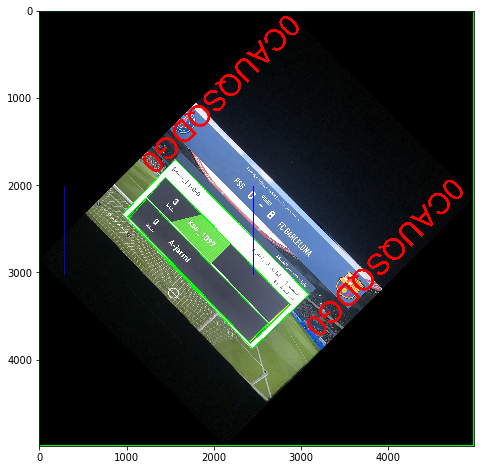

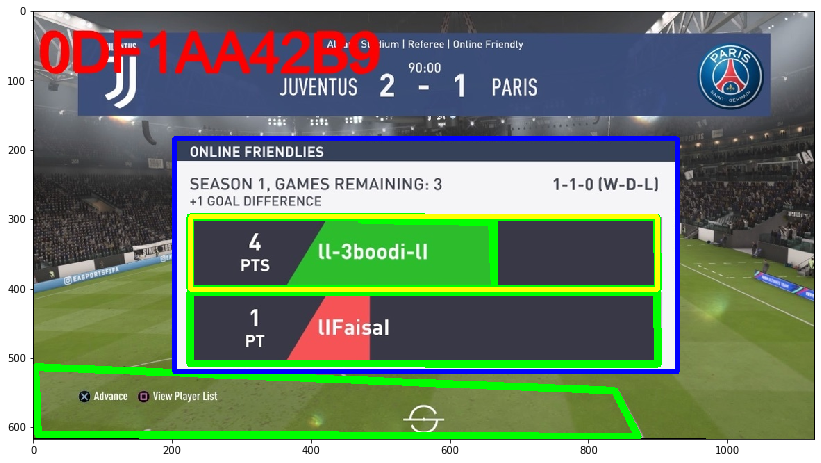

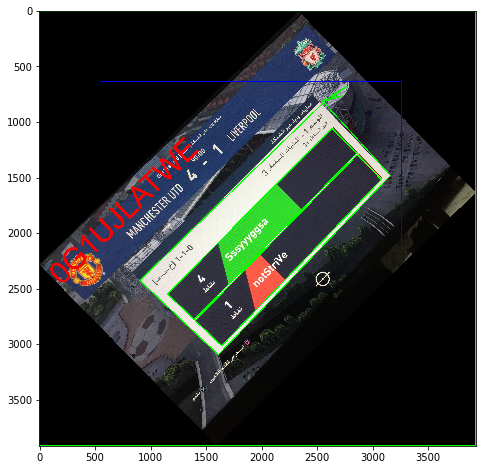

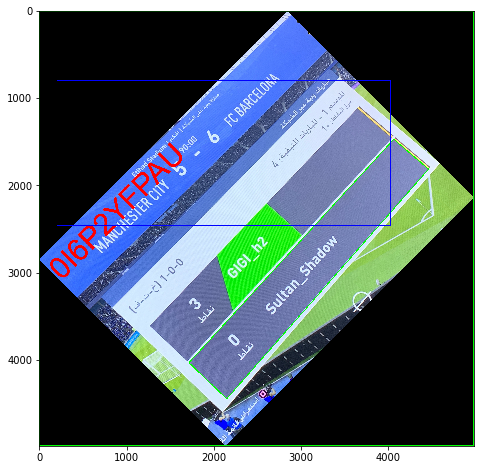

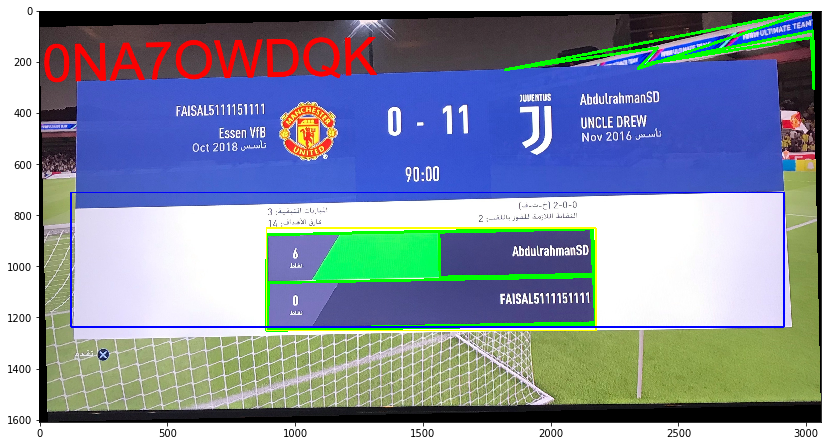

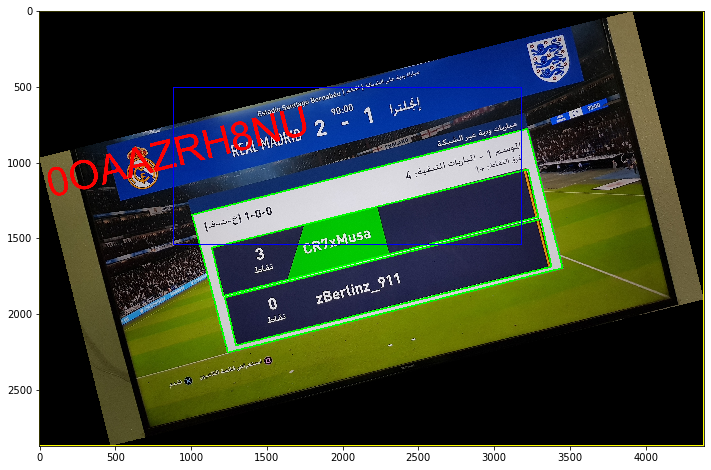

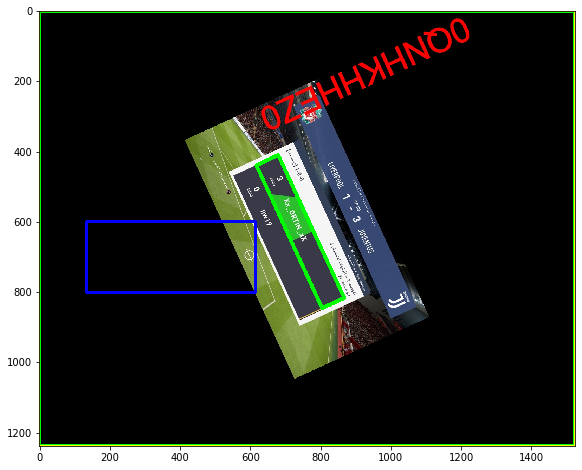

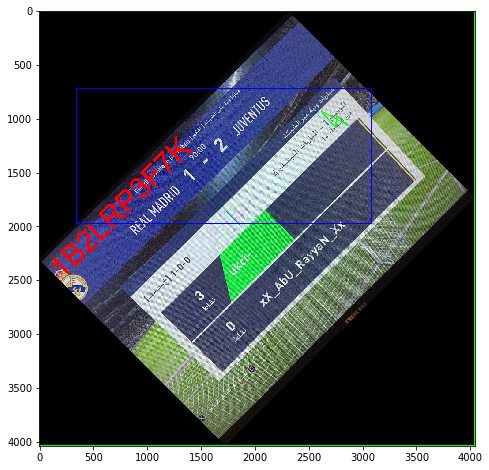

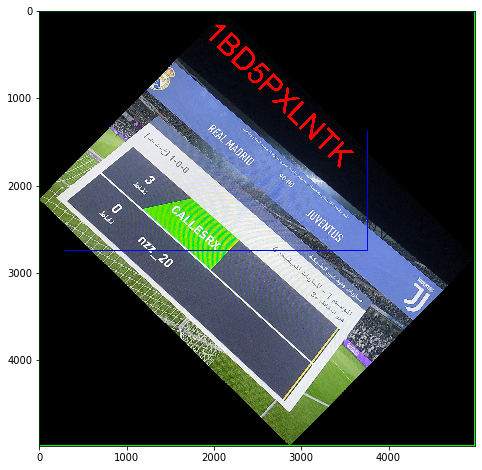

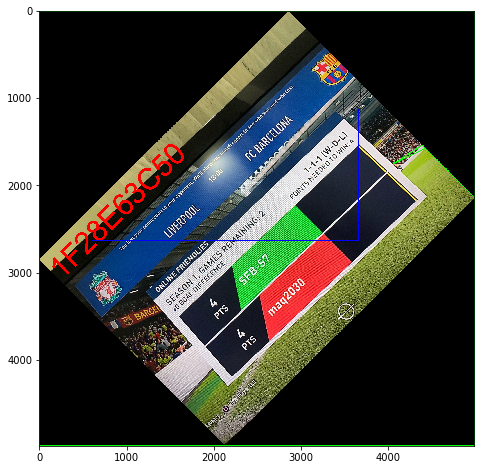

In [86]:
D={}
for f in files:
    img = cv2.imread(f)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
   # _,img_edit = cv2.threshold(gray, 160, 255, cv2.THRESH_BINARY_INV)
    img_edit=cv2.adaptiveThreshold(gray, 200, adaptiveMethod=cv2.ADAPTIVE_THRESH_GAUSSIAN_C, thresholdType=cv2.THRESH_BINARY_INV, blockSize=9, C=0)
    lines = cv2.HoughLinesP(img_edit, 1, np.pi/180, 100, minLineLength=1000, maxLineGap=20)
    
    angle=0
    for i in lines:
        x1,y1,x2,y2 = i[0]
        r = np.arctan2(y2-y1,x2-x1)
        angle+=r
        
    avr_ang = angle/len(lines)
    avr_degree = avr_ang * 180 / np.pi
    print (f'avr_degree: {avr_degree}')
    
    gray = ndimage.rotate(gray,avr_degree)
    img = ndimage.rotate(img,avr_degree)
    
    f_name = f.split('\\')[-1]
    final_contours, img_ed = detect_contour_bottom(gray, im_show=False, raw_img = img)
    if len(final_contours)>0:
        #acc = iou(final_contours[0],np.array(matches_map[f_name]['bottom']))
        boxA=coutour2rect(final_contours[0]).ravel()
        boxB=np.array(matches_map[f_name]['bottom']).ravel()
        acc = bb_intersection_over_union(boxA, boxB)
        draw_rect(coutour2rect(final_contours[0]),img_ed,(0,255,255))
        
    else:
        print('Detection fail')
        acc=0
    print(f'file: {f_name}')
    print(f'iou: {acc}')
    D[f_name]=acc
    draw_rect(matches_map[f_name]['bottom'],img_ed)
    
    plt.figure(figsize=(14,8))
    plt.imshow(cv2.cvtColor(img_ed, cv2.COLOR_BGR2RGB))
D

In [42]:
D

{'0CAUQSQDG0.jpg': 0.09547496042233164,
 '0DF1AA42B9.jpg': 0.2947344725263481,
 '0G1UJLATWE.jpg': 0.5237771769229783,
 '0I6P2YFPAU.jpg': 0.6868468129178044,
 '0NA7OWDQK.jpg': 0.257749970250648,
 '0OAAZRH8NU.jpg': 0.2982057017740643,
 '0QNHKHHEZ0.jpg': 0.07075574582916969,
 '1B2LRP3F7K.jpg': 0.2105850046268394,
 '1BD5PXLNTK.jpg': 0.20701616647930007,
 '1F28E63C50.jpg': 0.20813475718377958}

In [ ]:
#Test

Number of contours: 2
iou: 0.4299454386534025


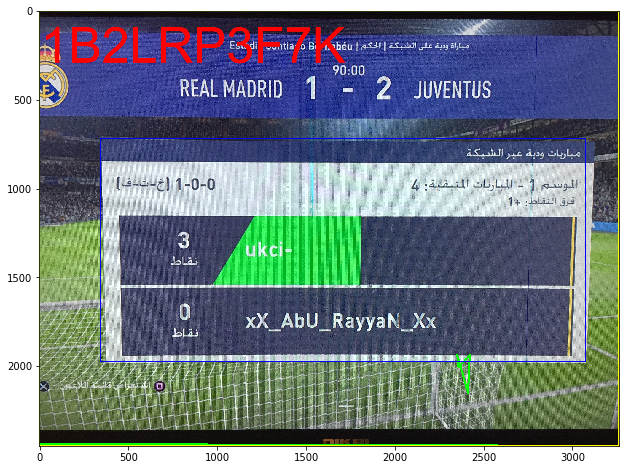

In [44]:
f='images\\screen_matches\\1B2LRP3F7K.jpg'
img = cv2.imread(f)
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
#_, gray = cv2.threshold(img, 150, 255, cv2.THRESH_BINARY)
f_name = f.split('\\')[-1]
final_contours, img_ed = detect_contour_bottom(gray, im_show=False, raw_img = img)
if len(final_contours)>0:
    #acc = iou(coutour2rect(final_contours[0]),np.array(matches_map[f_name]['bottom']))
    boxA=coutour2rect(final_contours[0]).ravel()
    boxB=np.array(matches_map[f_name]['bottom']).ravel()
    acc = bb_intersection_over_union(boxA, boxB)
    print(f'iou: {acc}')
draw_rect(matches_map[f_name]['bottom'],img_ed)
draw_rect(coutour2rect(final_contours[0]),img_ed,(0,255,255))
plt.figure(figsize=(14,8))
plt.imshow(cv2.cvtColor(img_ed, cv2.COLOR_BGR2RGB))

In [57]:
boxA

array([   0,    0, 3263, 2447], dtype=int32)

In [52]:
f='images\\screen_matches\\1B2LRP3F7K.jpg'
img = cv2.imread(f)
raw_img = img.copy()
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

Number of contours: 3


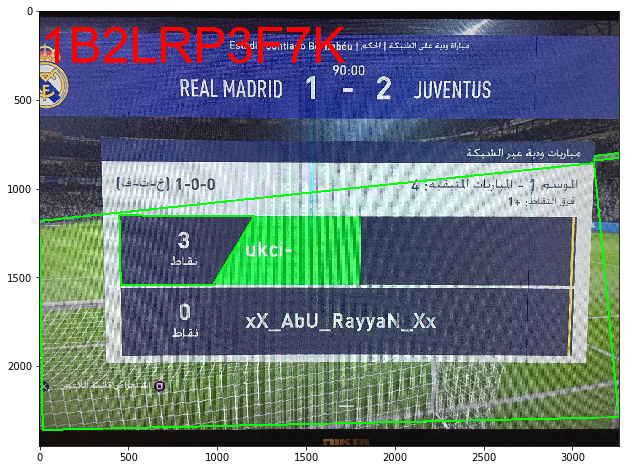

In [70]:
#thresh=cv2.adaptiveThreshold(gray, 200, adaptiveMethod=cv2.ADAPTIVE_THRESH_GAUSSIAN_C, thresholdType=cv2.THRESH_BINARY_INV, blockSize=9, C=0)
_, thresh = cv2.threshold(gray, 100, 255, cv2.THRESH_BINARY) 
contours, hierarchy = cv2.findContours(thresh, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
cnts = sorted(contours, key = cv2.contourArea, reverse = True)[:20]
# loop over our contours
final_contours = []
for c in cnts:
    # approximate the contour
    peri = cv2.arcLength(c, True)
    approx = cv2.approxPolyDP(c, 0.015 * peri, True)

    # if our approximated contour has four points, then
    # we can assume that we have found our screen
    if len(approx) == 4:
        final_contours.append(approx)
print(f'Number of contours: {len(final_contours)}')


img_ed=raw_img.copy()
for i in range(len(final_contours)):
    cnt = final_contours[i]
    cv2.drawContours(img_ed, [cnt], 0, (0,255,0), 10)

plt.figure(figsize=(14,8))
plt.imshow(cv2.cvtColor(img_ed, cv2.COLOR_BGR2RGB))
        

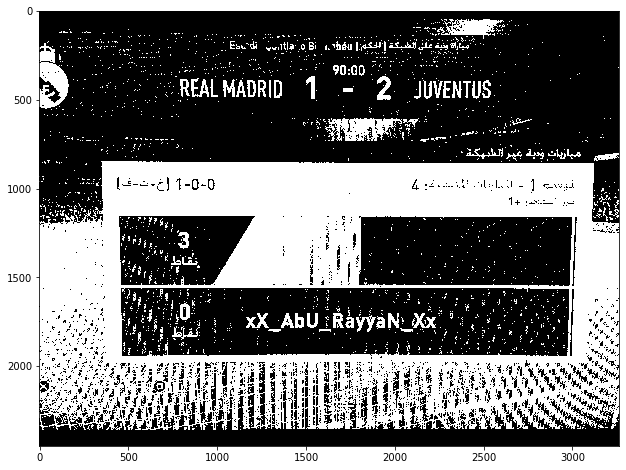

In [68]:
plt.figure(figsize=(14,8))
plt.imshow(cv2.cvtColor(thresh, cv2.COLOR_BGR2RGB))

In [71]:
f='images\\screen_matches\\1B2LRP3F7K.jpg'
img = cv2.imread(f)

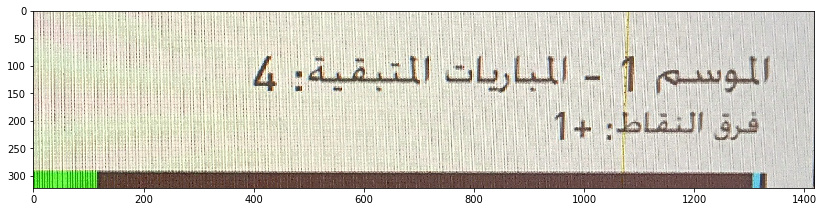

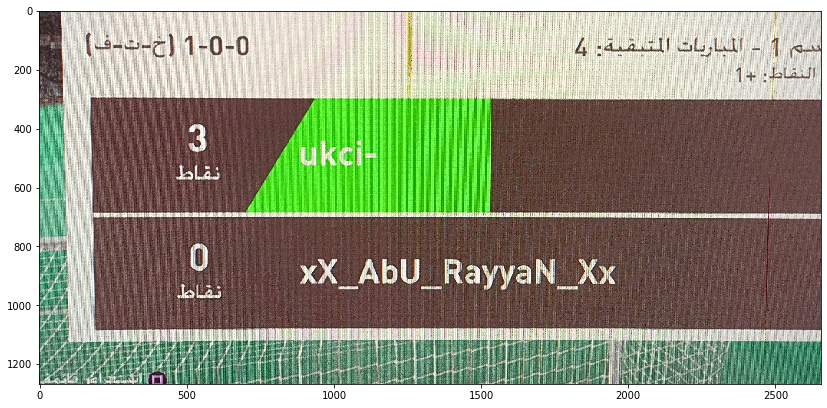

In [78]:
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
gray = cv2.bilateralFilter(gray, 11, 17, 17)

kernel = np.ones((5,5),np.uint8)
erosion = cv2.erode(gray,kernel,iterations = 2)
kernel = np.ones((4,4),np.uint8)
dilation = cv2.dilate(erosion,kernel,iterations = 2)

edged = cv2.Canny(dilation, 30, 200)

contours, hierarchy = cv2.findContours(edged, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

rects = [cv2.boundingRect(cnt) for cnt in contours]
rects = sorted(rects,key=lambda  x:x[1],reverse=True)

for rect in rects:
    x,y,w,h = rect
    area = w * h
    if area > 150000:
        out = img[y+10:y+h-10,x+10:x+w-10]
        plt.figure(figsize=(14,8))
        plt.imshow(out)

In [79]:
files

['images\\screen_matches\\0CAUQSQDG0.jpg',
 'images\\screen_matches\\0DF1AA42B9.jpg',
 'images\\screen_matches\\0G1UJLATWE.jpg',
 'images\\screen_matches\\0I6P2YFPAU.jpg',
 'images\\screen_matches\\0NA7OWDQK.jpg',
 'images\\screen_matches\\0OAAZRH8NU.jpg',
 'images\\screen_matches\\0QNHKHHEZ0.jpg',
 'images\\screen_matches\\1B2LRP3F7K.jpg',
 'images\\screen_matches\\1BD5PXLNTK.jpg',
 'images\\screen_matches\\1F28E63C50.jpg']

c:\users\vash\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


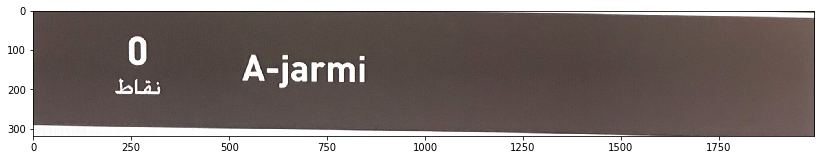

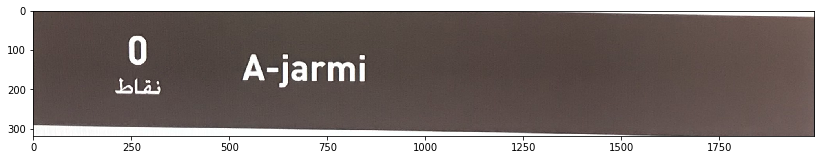

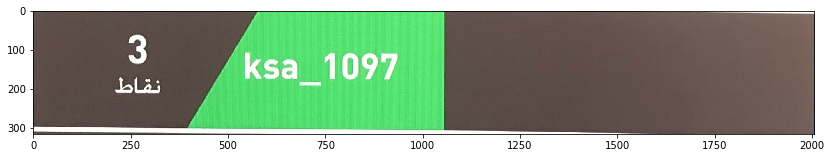

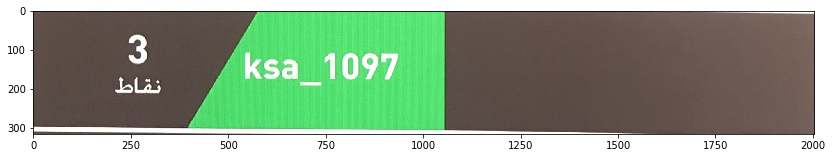

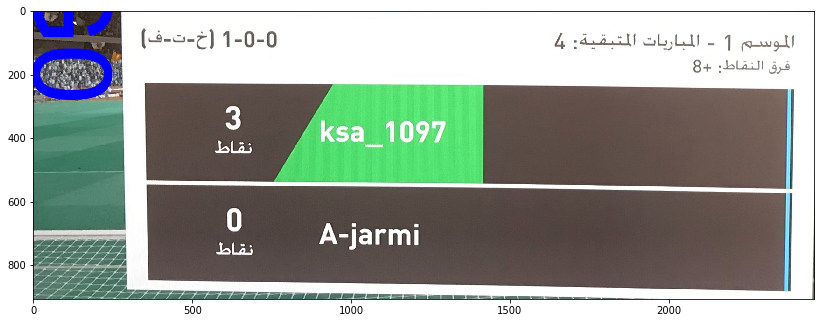

...

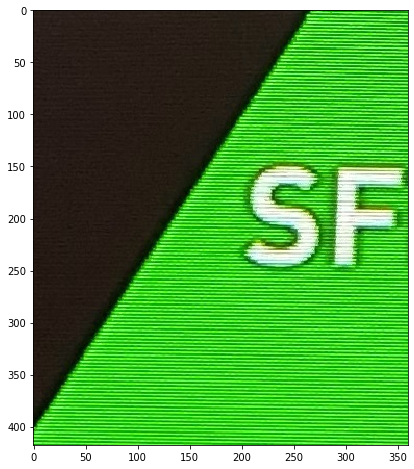

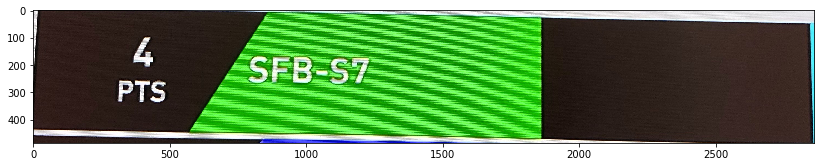

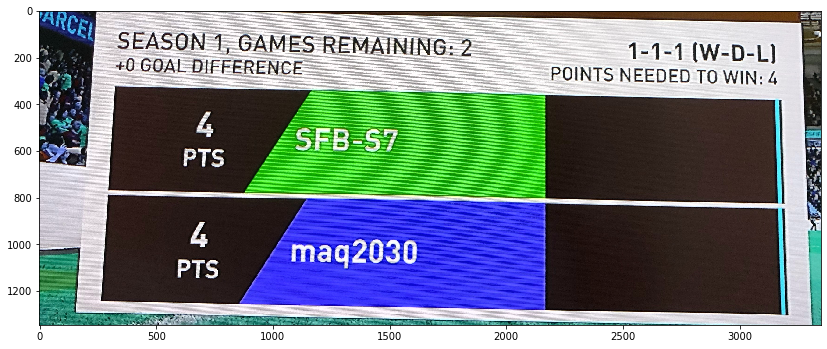

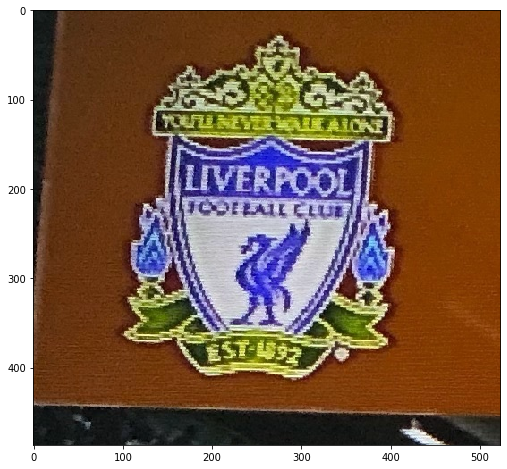

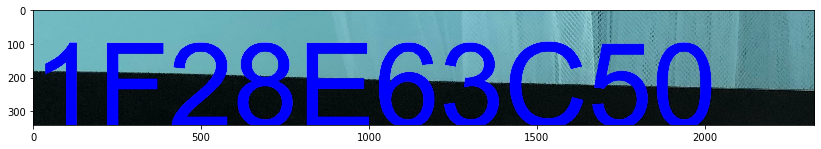

In [81]:
for f in files:
    img = cv2.imread(f)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    gray = cv2.bilateralFilter(gray, 11, 17, 17)

    kernel = np.ones((5,5),np.uint8)
    erosion = cv2.erode(gray,kernel,iterations = 2)
    kernel = np.ones((4,4),np.uint8)
    dilation = cv2.dilate(erosion,kernel,iterations = 2)

    edged = cv2.Canny(dilation, 30, 200)

    contours, hierarchy = cv2.findContours(edged, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

    rects = [cv2.boundingRect(cnt) for cnt in contours]
    rects = sorted(rects,key=lambda  x:x[1],reverse=True)

    for rect in rects:
        x,y,w,h = rect
        area = w * h
        if area > 150000:
            out = img[y+10:y+h-10,x+10:x+w-10]
            plt.figure(figsize=(14,8))
            plt.imshow(out)
    

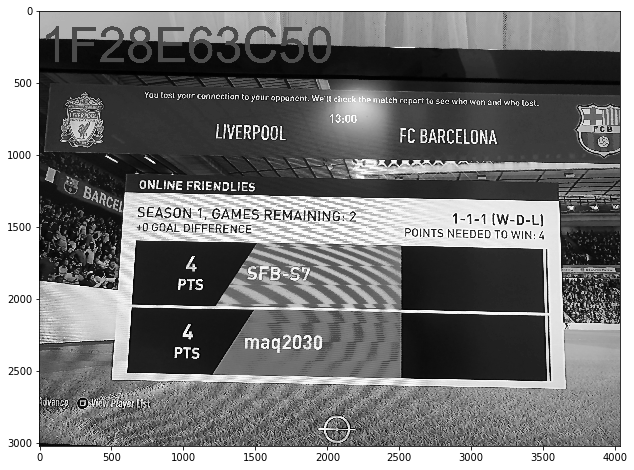

In [84]:
plt.figure(figsize=(14,8))
plt.imshow(gray, cmap='gray')

In [16]:
f='images/screen_matches/0DF1AA42B9.jpg'
img = cv2.imread(f)
raw_img = img.copy()
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

Number of contours: 3


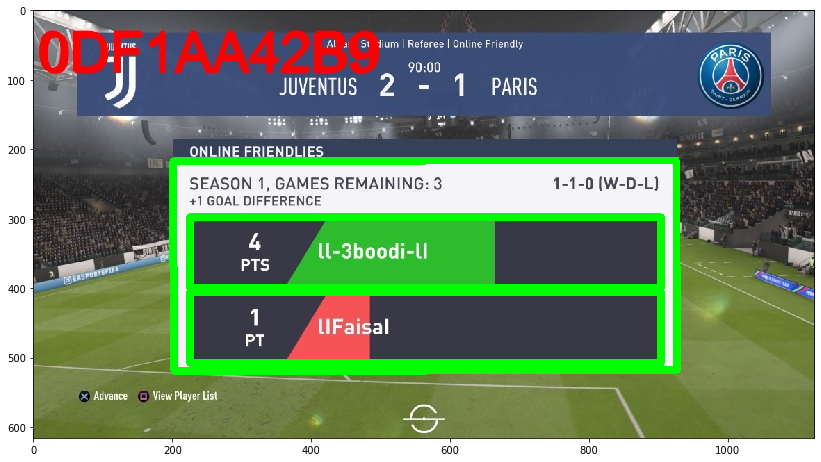

In [17]:
#thresh=cv2.adaptiveThreshold(gray, 200, adaptiveMethod=cv2.ADAPTIVE_THRESH_GAUSSIAN_C, thresholdType=cv2.THRESH_BINARY_INV, blockSize=9, C=0)
_, thresh = cv2.threshold(gray, 200, 255, cv2.THRESH_BINARY_INV) 
contours, hierarchy = cv2.findContours(thresh, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
cnts = sorted(contours, key = cv2.contourArea, reverse = True)[:20]
# loop over our contours
final_contours = []
for c in cnts:
    # approximate the contour
    peri = cv2.arcLength(c, True)
    approx = cv2.approxPolyDP(c, 0.015 * peri, True)

    # if our approximated contour has four points, then
    # we can assume that we have found our screen
    if len(approx) == 4:
        final_contours.append(approx)
print(f'Number of contours: {len(final_contours)}')


img_ed=raw_img.copy()
for i in range(len(final_contours)):
    cnt = final_contours[i]
    cv2.drawContours(img_ed, [cnt], 0, (0,255,0), 10)

plt.figure(figsize=(14,8))
plt.imshow(cv2.cvtColor(img_ed, cv2.COLOR_BGR2RGB))
    

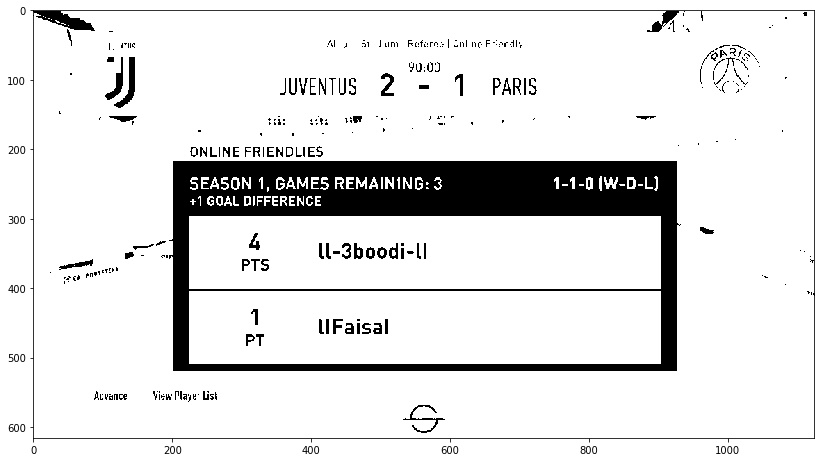

In [18]:
plt.figure(figsize=(14,8))
plt.imshow(cv2.cvtColor(thresh, cv2.COLOR_BGR2RGB))

Number of contours: 4


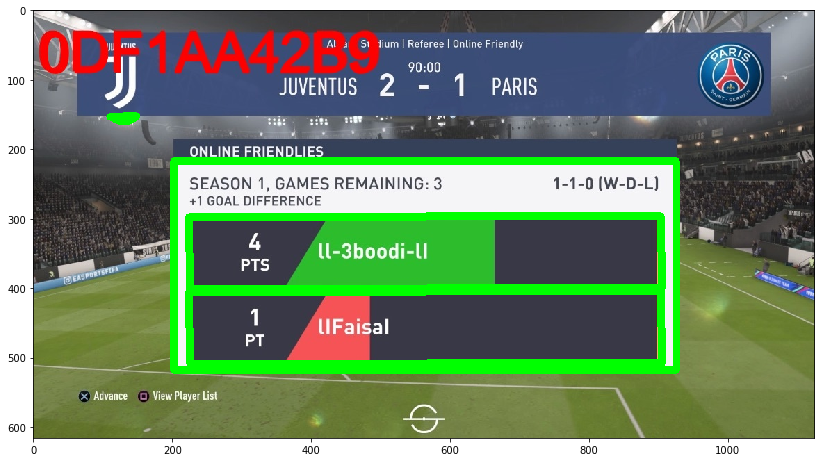

In [20]:
#thresh=cv2.adaptiveThreshold(gray, 200, adaptiveMethod=cv2.ADAPTIVE_THRESH_GAUSSIAN_C, thresholdType=cv2.THRESH_BINARY_INV, blockSize=9, C=0)
_, thresh = cv2.threshold(gray, 200, 255, cv2.THRESH_BINARY)
contours, hierarchy = cv2.findContours(thresh, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
cnts = sorted(contours, key = cv2.contourArea, reverse = True)[:20]
# loop over our contours
final_contours = []
for c in cnts:
    # approximate the contour
    peri = cv2.arcLength(c, True)
    approx = cv2.approxPolyDP(c, 0.015 * peri, True)

    # if our approximated contour has four points, then
    # we can assume that we have found our screen
    if len(approx) == 4:
        final_contours.append(approx)
print(f'Number of contours: {len(final_contours)}')


img_ed=raw_img.copy()
for i in range(len(final_contours)):
    cnt = final_contours[i]
    cv2.drawContours(img_ed, [cnt], 0, (0,255,0), 10)

plt.figure(figsize=(14,8))
plt.imshow(cv2.cvtColor(img_ed, cv2.COLOR_BGR2RGB))
    

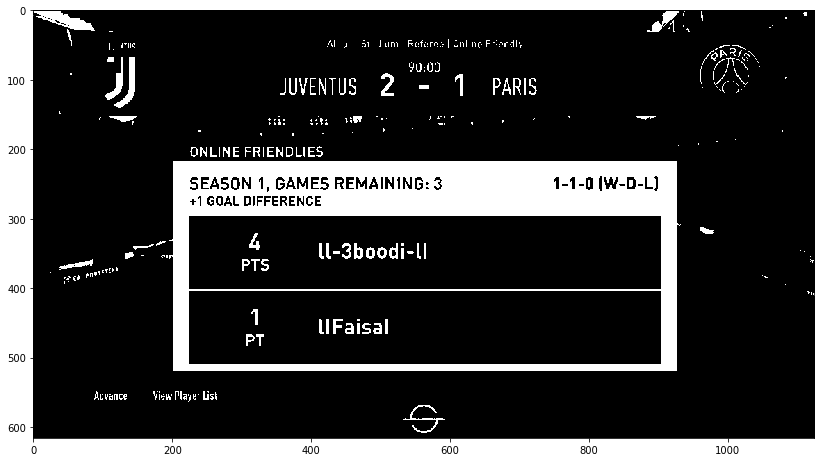

In [21]:
plt.figure(figsize=(14,8))
plt.imshow(cv2.cvtColor(thresh, cv2.COLOR_BGR2RGB))

Number of contours: 2


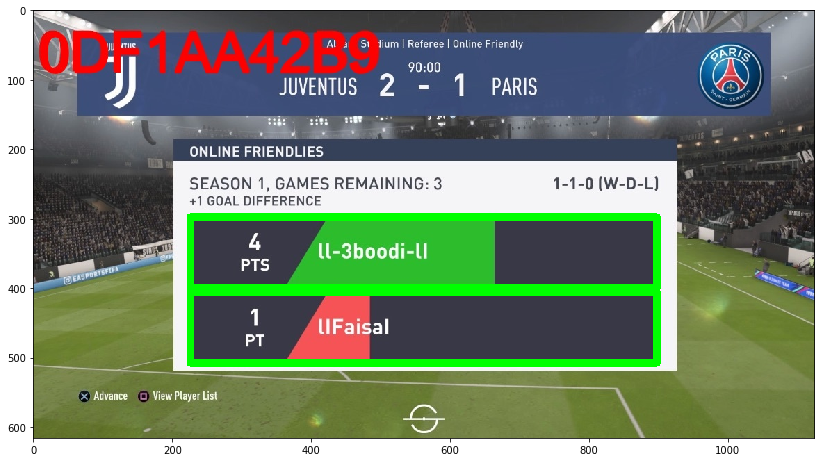

In [28]:
#thresh=cv2.adaptiveThreshold(gray, 200, adaptiveMethod=cv2.ADAPTIVE_THRESH_GAUSSIAN_C, thresholdType=cv2.THRESH_BINARY_INV, blockSize=9, C=0)
img = cv2.imread(f)
raw_img = img.copy()
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
gray = cv2.bitwise_not(gray)
_, thresh = cv2.threshold(gray, 100, 255, cv2.THRESH_BINARY)
contours, hierarchy = cv2.findContours(thresh, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
cnts = sorted(contours, key = cv2.contourArea, reverse = True)[:20]
# loop over our contours
final_contours = []
for c in cnts:
    # approximate the contour
    peri = cv2.arcLength(c, True)
    approx = cv2.approxPolyDP(c, 0.015 * peri, True)

    # if our approximated contour has four points, then
    # we can assume that we have found our screen
    if len(approx) == 4:
        final_contours.append(approx)
print(f'Number of contours: {len(final_contours)}')


img_ed=raw_img.copy()
for i in range(len(final_contours)):
    cnt = final_contours[i]
    cv2.drawContours(img_ed, [cnt], 0, (0,255,0), 10)

plt.figure(figsize=(14,8))
plt.imshow(cv2.cvtColor(img_ed, cv2.COLOR_BGR2RGB))

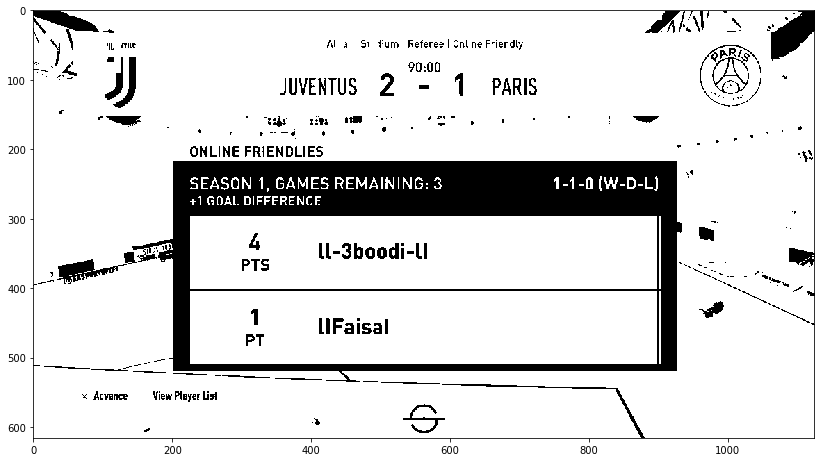

In [29]:
plt.figure(figsize=(14,8))
plt.imshow(cv2.cvtColor(thresh, cv2.COLOR_BGR2RGB))

Number of contours: 3


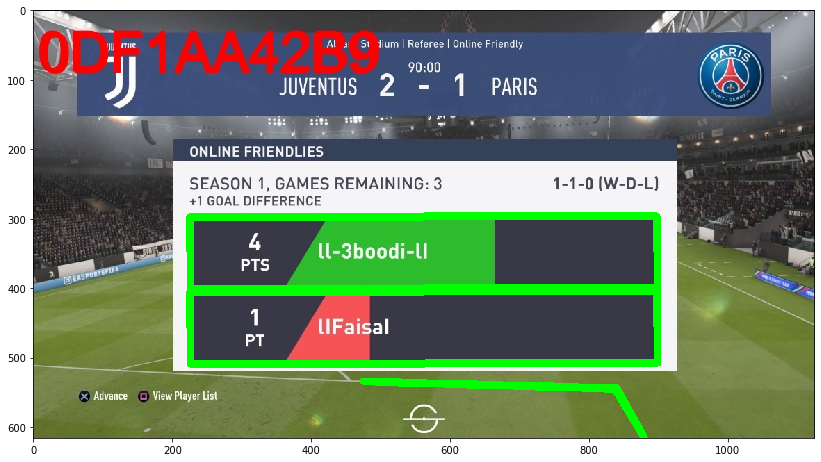

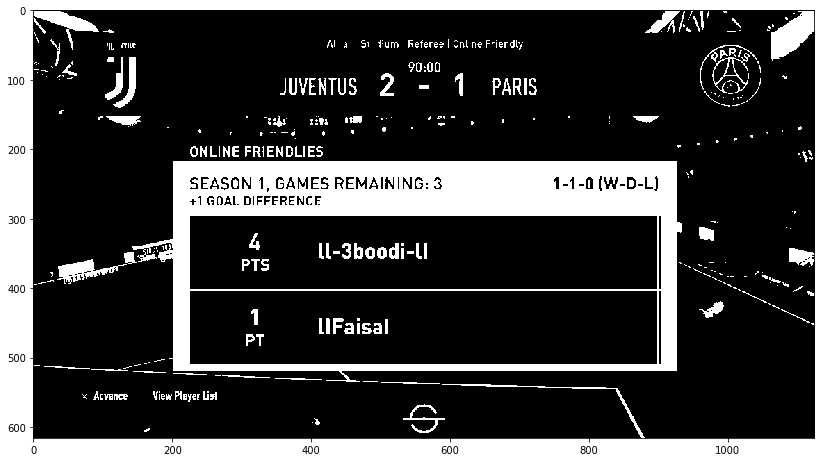

In [27]:
#thresh=cv2.adaptiveThreshold(gray, 200, adaptiveMethod=cv2.ADAPTIVE_THRESH_GAUSSIAN_C, thresholdType=cv2.THRESH_BINARY_INV, blockSize=9, C=0)
f='images/screen_matches/0DF1AA42B9.jpg'
img = cv2.imread(f)
raw_img = img.copy()
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
gray = cv2.bitwise_not(gray)
_, thresh = cv2.threshold(gray, 100, 255, cv2.THRESH_BINARY_INV)
contours, hierarchy = cv2.findContours(thresh, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
cnts = sorted(contours, key = cv2.contourArea, reverse = True)[:20]
# loop over our contours
final_contours = []
for c in cnts:
    # approximate the contour
    peri = cv2.arcLength(c, True)
    approx = cv2.approxPolyDP(c, 0.015 * peri, True)

    # if our approximated contour has four points, then
    # we can assume that we have found our screen
    if len(approx) == 4:
        final_contours.append(approx)
print(f'Number of contours: {len(final_contours)}')


img_ed=raw_img.copy()
for i in range(len(final_contours)):
    cnt = final_contours[i]
    cv2.drawContours(img_ed, [cnt], 0, (0,255,0), 10)

plt.figure(figsize=(14,8))
plt.imshow(cv2.cvtColor(img_ed, cv2.COLOR_BGR2RGB))

plt.figure(figsize=(14,8))
plt.imshow(cv2.cvtColor(thresh, cv2.COLOR_BGR2RGB))

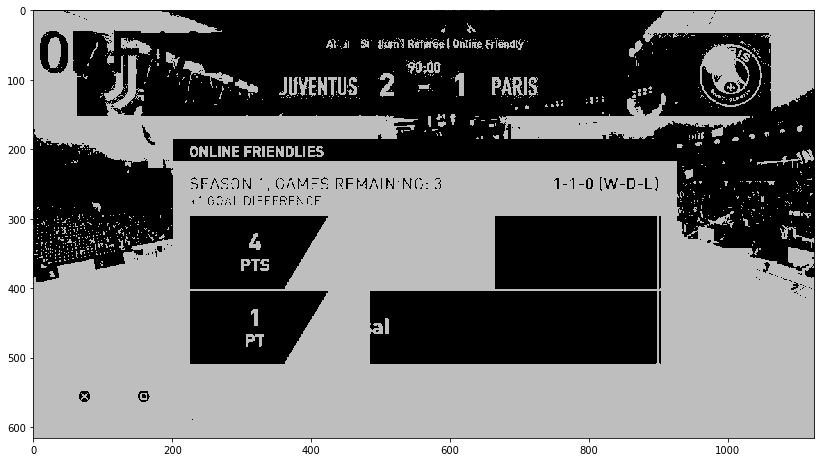

In [46]:
f='images/screen_matches/0DF1AA42B9.jpg'
img = cv2.imread(f)
raw_img = img.copy()
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
#gray = cv2.bitwise_not(gray)
_, thresh = cv2.threshold(gray, 80, 190, cv2.THRESH_BINARY)
plt.figure(figsize=(14,8))
plt.imshow(cv2.cvtColor(thresh, cv2.COLOR_BGR2RGB))

Number of contours: 4


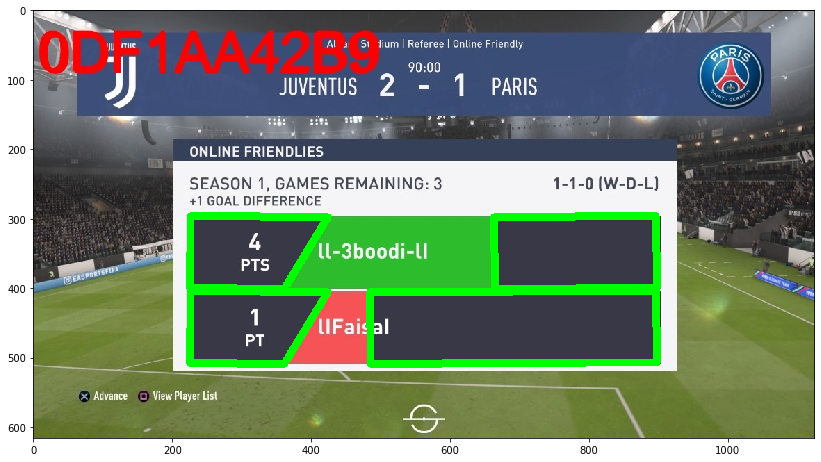

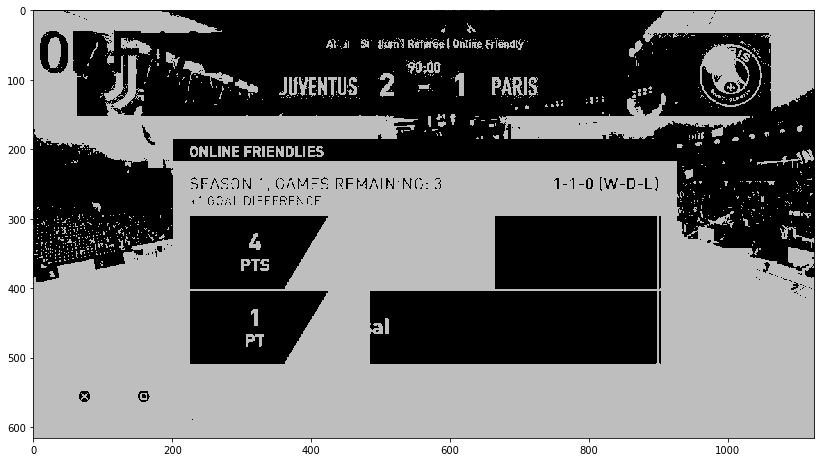

In [47]:
f='images/screen_matches/0DF1AA42B9.jpg'
img = cv2.imread(f)
raw_img = img.copy()
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
#gray = cv2.bitwise_not(gray)
_, thresh = cv2.threshold(gray, 80, 190, cv2.THRESH_BINARY)
contours, hierarchy = cv2.findContours(thresh, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
cnts = sorted(contours, key = cv2.contourArea, reverse = True)[:20]
# loop over our contours
final_contours = []
for c in cnts:
    # approximate the contour
    peri = cv2.arcLength(c, True)
    approx = cv2.approxPolyDP(c, 0.015 * peri, True)

    # if our approximated contour has four points, then
    # we can assume that we have found our screen
    if len(approx) == 4:
        final_contours.append(approx)
print(f'Number of contours: {len(final_contours)}')


img_ed=raw_img.copy()
for i in range(len(final_contours)):
    cnt = final_contours[i]
    cv2.drawContours(img_ed, [cnt], 0, (0,255,0), 10)

plt.figure(figsize=(14,8))
plt.imshow(cv2.cvtColor(img_ed, cv2.COLOR_BGR2RGB))

plt.figure(figsize=(14,8))
plt.imshow(cv2.cvtColor(thresh, cv2.COLOR_BGR2RGB))

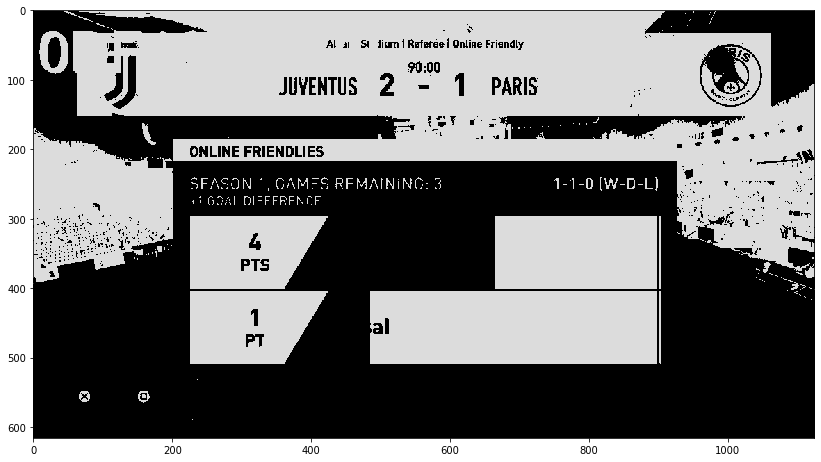

In [66]:
f='images/screen_matches/0DF1AA42B9.jpg'
img = cv2.imread(f)
raw_img = img.copy()
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
#gray = cv2.bitwise_not(gray)
_, thresh = cv2.threshold(gray, 170, 220, cv2.THRESH_BINARY)
plt.figure(figsize=(14,8))
plt.imshow(cv2.cvtColor(thresh, cv2.COLOR_BGR2RGB))

Number of contours: 5


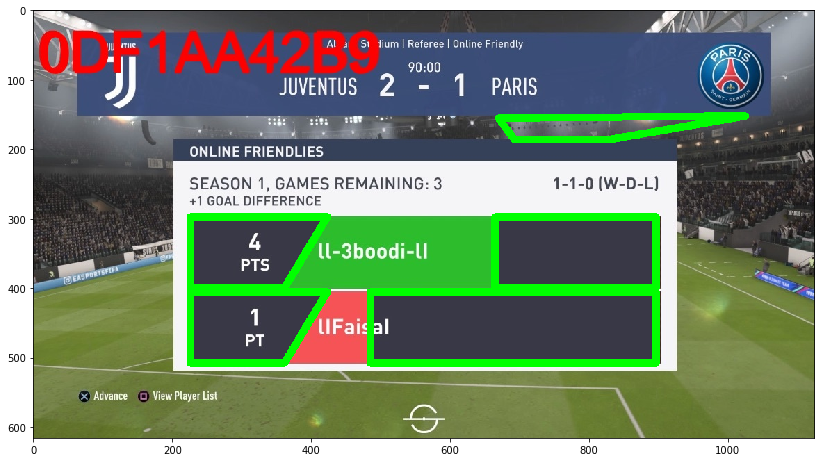

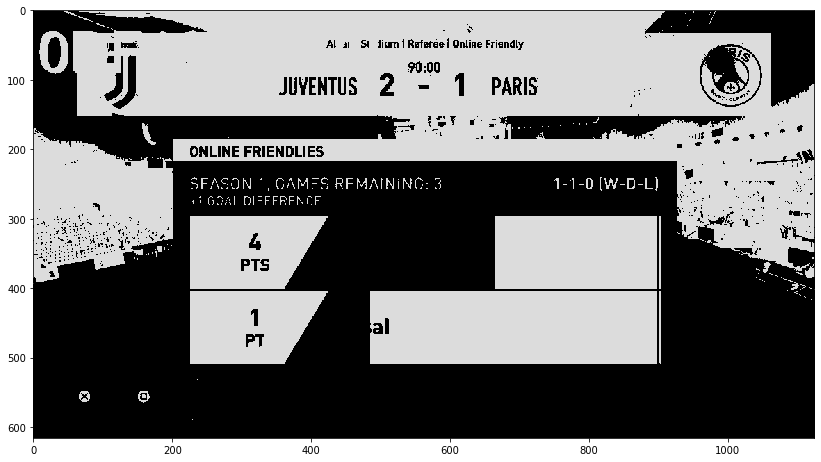

In [67]:
f='images/screen_matches/0DF1AA42B9.jpg'
img = cv2.imread(f)
raw_img = img.copy()
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
gray = cv2.bitwise_not(gray)
_, thresh = cv2.threshold(gray, 170, 220, cv2.THRESH_BINARY)
contours, hierarchy = cv2.findContours(thresh, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
cnts = sorted(contours, key = cv2.contourArea, reverse = True)[:20]
# loop over our contours
final_contours = []
for c in cnts:
    # approximate the contour
    peri = cv2.arcLength(c, True)
    approx = cv2.approxPolyDP(c, 0.015 * peri, True)

    # if our approximated contour has four points, then
    # we can assume that we have found our screen
    if len(approx) == 4:
        final_contours.append(approx)
print(f'Number of contours: {len(final_contours)}')


img_ed=raw_img.copy()
for i in range(len(final_contours)):
    cnt = final_contours[i]
    cv2.drawContours(img_ed, [cnt], 0, (0,255,0), 10)

plt.figure(figsize=(14,8))
plt.imshow(cv2.cvtColor(img_ed, cv2.COLOR_BGR2RGB))

plt.figure(figsize=(14,8))
plt.imshow(cv2.cvtColor(thresh, cv2.COLOR_BGR2RGB))

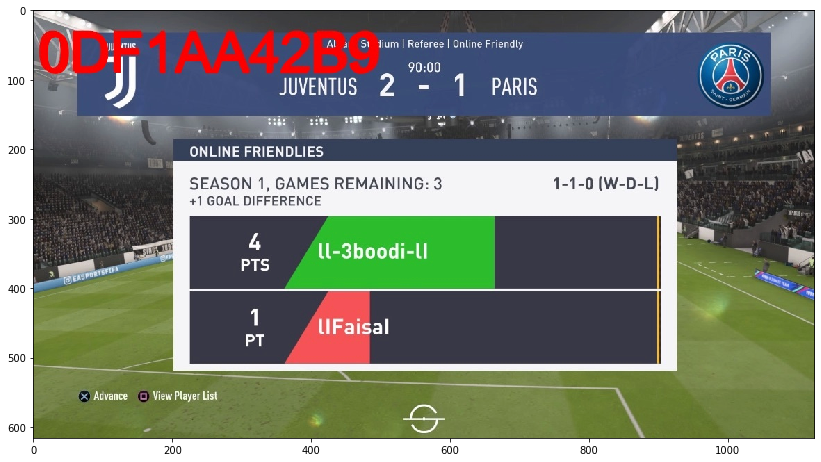

In [76]:
#BGR
hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
plt.figure(figsize=(14,8))
plt.imshow(cv2.cvtColor(hsv, cv2.COLOR_HSV2RGB))

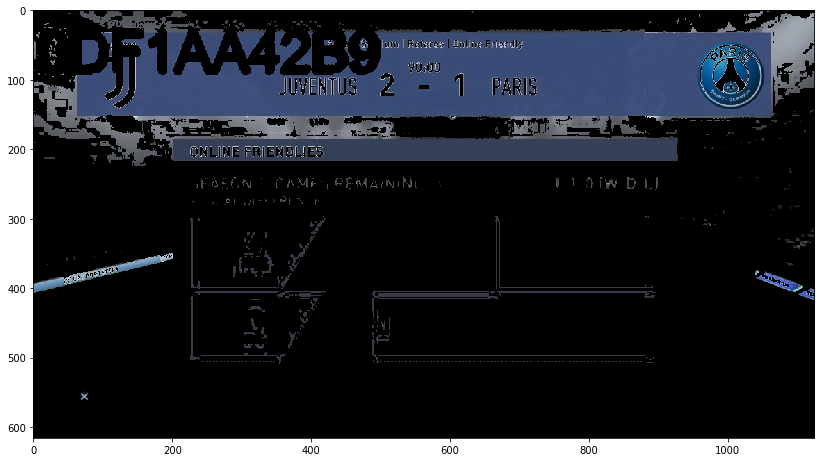

In [126]:
lower_color = np.array([80,20,0])
upper_color = np.array([120,255,230])
mask = cv2.inRange(hsv,lower_color, upper_color)
res = cv2.bitwise_and(hsv,hsv,mask=mask)
plt.figure(figsize=(14,8))
plt.imshow(cv2.cvtColor(res, cv2.COLOR_HSV2RGB))

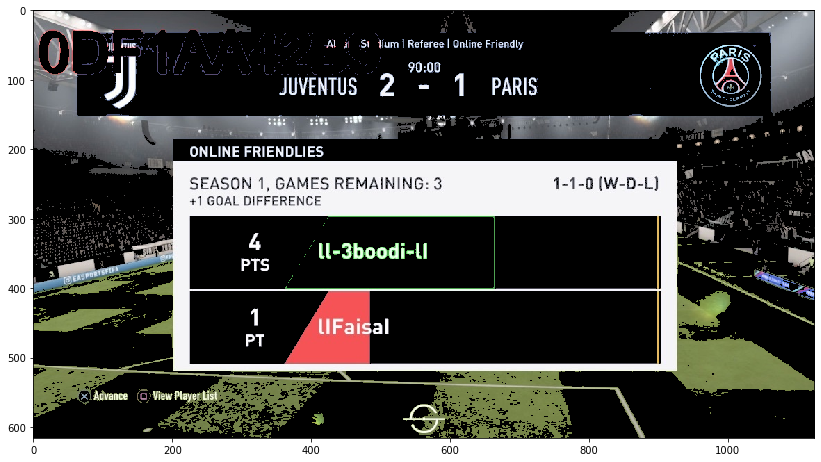

In [166]:
f='images/screen_matches/0DF1AA42B9.jpg'
img = cv2.imread(f)

lower_color = np.array([70,70,70])
upper_color = np.array([255,255,255])
mask = cv2.inRange(img,lower_color, upper_color)
res = cv2.bitwise_and(img,img,mask=mask)
plt.figure(figsize=(14,8))
plt.imshow(cv2.cvtColor(res, cv2.COLOR_BGR2RGB))

Number of contours: 4


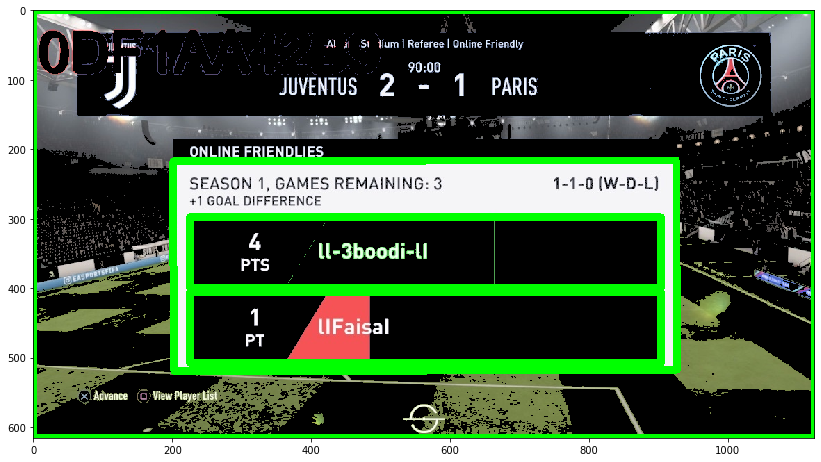

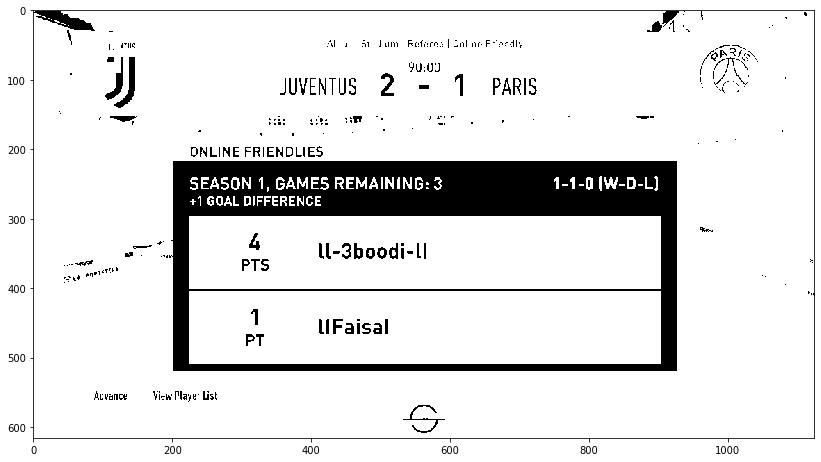

In [171]:
f='images/screen_matches/0DF1AA42B9.jpg'
img = cv2.imread(f)
img = res.copy()
raw_img = img.copy()

gray = cv2.cvtColor(res, cv2.COLOR_BGR2GRAY)
gray = cv2.bitwise_not(gray)
_, thresh = cv2.threshold(gray, 50, 255, cv2.THRESH_BINARY)
contours, hierarchy = cv2.findContours(thresh, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
cnts = sorted(contours, key = cv2.contourArea, reverse = True)[:20]
# loop over our contours
final_contours = []
for c in cnts:
    # approximate the contour
    peri = cv2.arcLength(c, True)
    approx = cv2.approxPolyDP(c, 0.015 * peri, True)

    # if our approximated contour has four points, then
    # we can assume that we have found our screen
    if len(approx) == 4:
        final_contours.append(approx)
print(f'Number of contours: {len(final_contours)}')


img_ed=raw_img.copy()
for i in range(len(final_contours)):
    cnt = final_contours[i]
    cv2.drawContours(img_ed, [cnt], 0, (0,255,0), 10)

plt.figure(figsize=(14,8))
plt.imshow(cv2.cvtColor(img_ed, cv2.COLOR_BGR2RGB))

plt.figure(figsize=(14,8))
plt.imshow(cv2.cvtColor(thresh, cv2.COLOR_BGR2RGB))

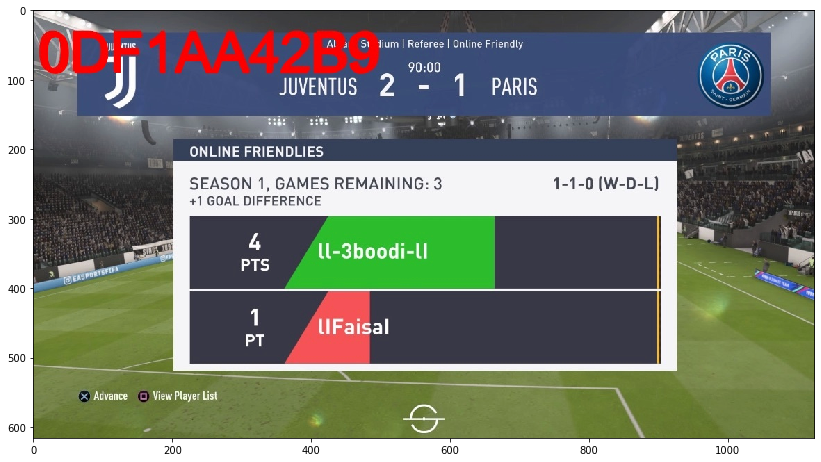

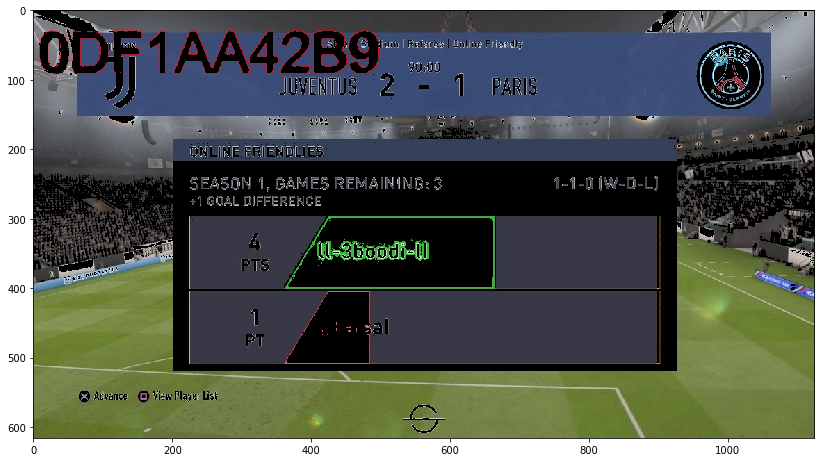

In [252]:
f='images/screen_matches/0DF1AA42B9.jpg'
img = cv2.imread(f)

hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
plt.figure(figsize=(14,8))
plt.imshow(cv2.cvtColor(hsv, cv2.COLOR_HSV2RGB))

lower_color = np.array([0,0,50])
upper_color = np.array([255,255,200])
mask = cv2.inRange(img,lower_color, upper_color)
res = cv2.bitwise_and(hsv,hsv,mask=mask)
plt.figure(figsize=(14,8))
plt.imshow(cv2.cvtColor(res, cv2.COLOR_HSV2RGB))

Number of contours: 2


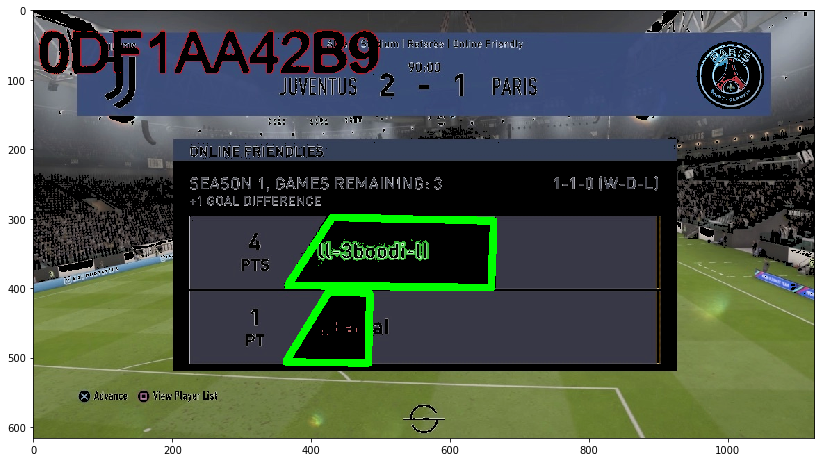

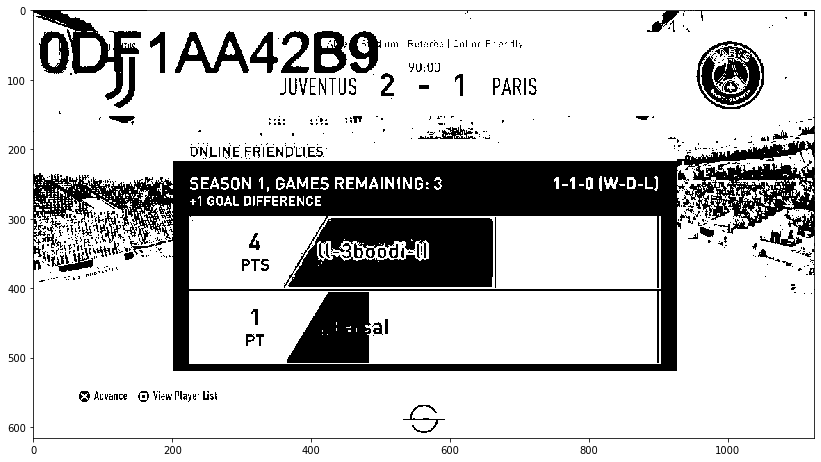

In [253]:
f='images/screen_matches/0DF1AA42B9.jpg'
#img = cv2.imread(f)
img = cv2.cvtColor(res,cv2.COLOR_HSV2BGR)
raw_img = img.copy()

gray = cv2.cvtColor(res, cv2.COLOR_BGR2GRAY)
#gray = cv2.bitwise_not(gray)
_, thresh = cv2.threshold(gray, 1, 255, cv2.THRESH_BINARY)
contours, hierarchy = cv2.findContours(thresh, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
cnts = sorted(contours, key = cv2.contourArea, reverse = True)[:20]
# loop over our contours
final_contours = []
for c in cnts:
    # approximate the contour
    peri = cv2.arcLength(c, True)
    approx = cv2.approxPolyDP(c, 0.015 * peri, True)

    # if our approximated contour has four points, then
    # we can assume that we have found our screen
    if len(approx) == 4:
        final_contours.append(approx)
print(f'Number of contours: {len(final_contours)}')


img_ed=raw_img.copy()
for i in range(len(final_contours)):
    cnt = final_contours[i]
    cv2.drawContours(img_ed, [cnt], 0, (0,255,0), 10)

plt.figure(figsize=(14,8))
plt.imshow(cv2.cvtColor(img_ed, cv2.COLOR_BGR2RGB))

plt.figure(figsize=(14,8))
plt.imshow(cv2.cvtColor(thresh, cv2.COLOR_BGR2RGB))

cnts: 239


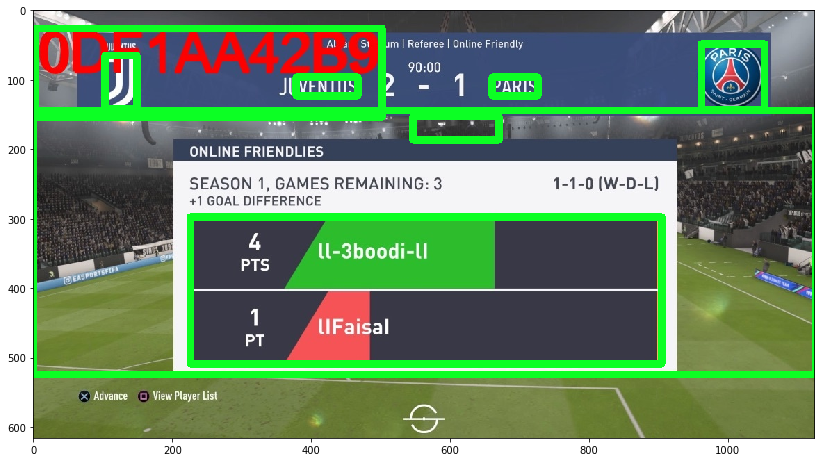

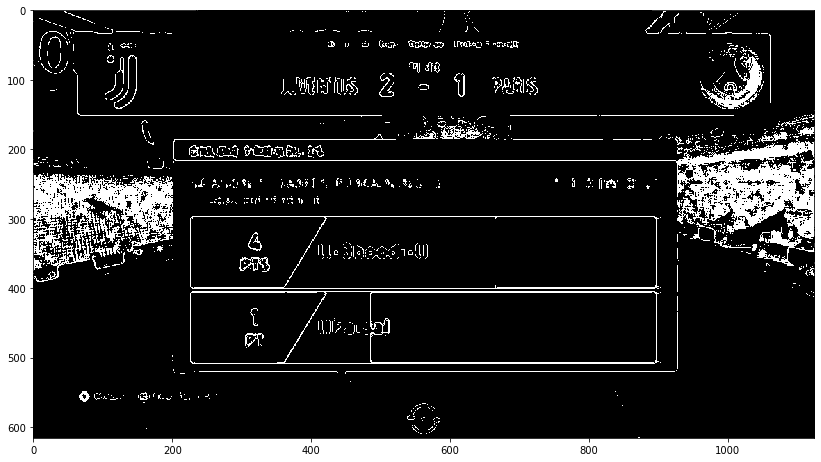

In [18]:
f='images/screen_matches/0DF1AA42B9.jpg'
image = cv2.imread(f)

gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
blur = cv2.medianBlur(gray, 7)
sharpen_kernel = np.array([[-1,-1,-1], [-1,9,-1], [-1,-1,-1]])
sharpen = cv2.filter2D(blur, -1, sharpen_kernel)

thresh = cv2.threshold(sharpen,50,255, cv2.THRESH_BINARY_INV)[1]
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (3,3))
close = cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, kernel, iterations=2)

cnts = cv2.findContours(close, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
cnts = cnts[0] if len(cnts) == 2 else cnts[1]

min_area = 700
max_area = 15000000
image_number = 0
print(f'cnts: {len(cnts)}')
for c in cnts:
    area = cv2.contourArea(c)
    if area > min_area and area < max_area:
        x,y,w,h = cv2.boundingRect(c)
        ROI = image[y:y+h, x:x+h]
        #cv2.imwrite('ROI_{}.png'.format(image_number), ROI)
        cv2.rectangle(image, (x, y), (x + w, y + h), (36,255,12), 10)
        image_number += 1

# cv2.imshow('sharpen', sharpen)
# cv2.imshow('close', close)
# cv2.imshow('thresh', thresh)
# cv2.imshow('image', image)
# cv2.waitKey(0)
# cv2.destroyAllWindows()
plt.figure(figsize=(14,8))
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.figure(figsize=(14,8))
plt.imshow(cv2.cvtColor(thresh, cv2.COLOR_BGR2RGB))

In [19]:
cnts_sorted = sorted(cnts, key = cv2.contourArea, reverse = True)[:20]

In [21]:
x,y,w,h = cv2.boundingRect(cnts_sorted[0])

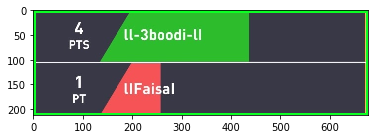

In [27]:
plt.imshow(cv2.cvtColor(image[y:y+h,x:x+w], cv2.COLOR_BGR2RGB))

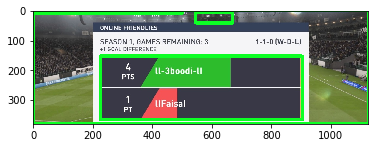

In [28]:
x,y,w,h = cv2.boundingRect(cnts_sorted[1])
plt.imshow(cv2.cvtColor(image[y:y+h,x:x+w], cv2.COLOR_BGR2RGB))

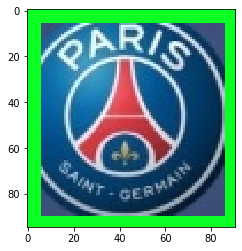

In [29]:
x,y,w,h = cv2.boundingRect(cnts_sorted[2])
plt.imshow(cv2.cvtColor(image[y:y+h,x:x+w], cv2.COLOR_BGR2RGB))

cnts: 239
533566
525402
98778
523064
94642
310580
509980
507669
503059
306852
320712
499960
487900
481096
478836
269916
145377
129955
463967
67404
144624
80660
94428
466146
461738
130560
114608
95874
60059
95150
27050
71690
97552
461668
453985
26600
239317
237442
234150
434105
436800
434218
433315
427280
21450
26316
27792
32172
39690
35720
392625
376232
67851
7954
69094
69615
385624
344715
54257
46800
366417
38420
97310
55854
68310
69692
101235
87210
85170
83916
71655
133078
216619
103664
133332
63960
138908
71492
213597
140360
63574
53058
215864
131211
115690
113620
109020
102333
97407
70840
77112
65780
66920
56350
178649
177184
176330
175310
101916
98210
90288
49932
188384
15525
8360
8463
27675
7992
6020
8120
37347
6360
3587
7920
178340
125060
142191
125120
162719
163443
95407
181738
92748
95049
94864
168175
94675
181656
95178
169632
93366
168
163968
165816
92064
94952
174900
79170
90528
89516
83398
64960
80160
70626
17112
55107
96866
97920
94554
96976
76176
97999
86730
49374
54236
2

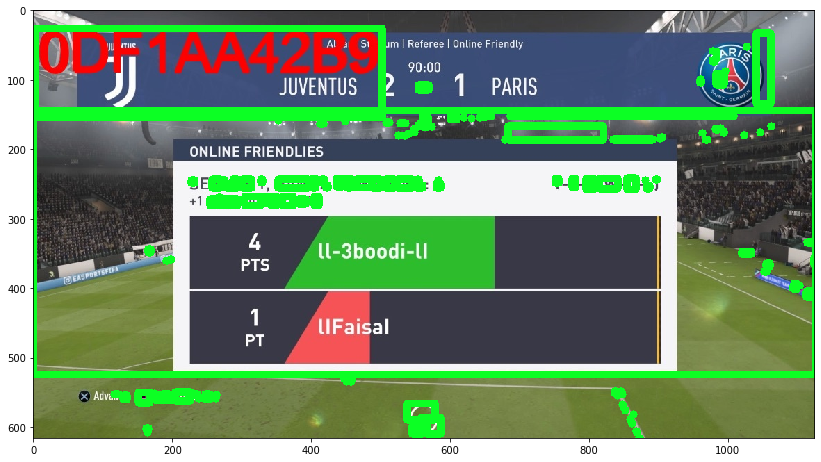

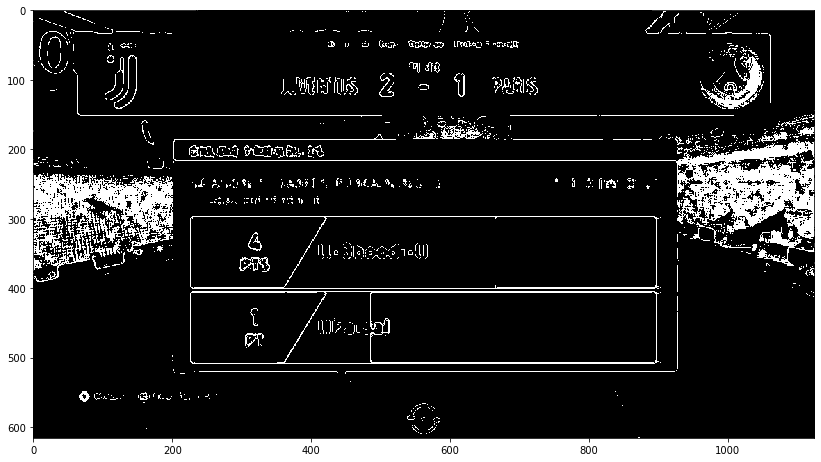

In [37]:
f='images/screen_matches/0DF1AA42B9.jpg'
image = cv2.imread(f)

gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
blur = cv2.medianBlur(gray, 7)
sharpen_kernel = np.array([[-1,-1,-1], [-1,9,-1], [-1,-1,-1]])
sharpen = cv2.filter2D(blur, -1, sharpen_kernel)

thresh = cv2.threshold(sharpen,50,255, cv2.THRESH_BINARY_INV)[1]
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (3,3))
close = cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, kernel, iterations=2)

cnts = cv2.findContours(close, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
cnts = cnts[0] if len(cnts) == 2 else cnts[1]
cnts = [cv2.boundingRect(c) for c in cnts]
min_area = 50000
max_area = 15000000
print(f'cnts: {len(cnts)}')
for c in cnts:
    #area = cv2.contourArea(c)
    area = np.abs((c[2]-c[0])*(c[3]-c[1]))
    print(area)
    if area > min_area and area < max_area:
        x,y,w,h = c
        ROI = image[y:y+h, x:x+h]
        cv2.rectangle(image, (x, y), (x + w, y + h), (36,255,12), 10)


# cv2.imshow('sharpen', sharpen)
# cv2.imshow('close', close)
# cv2.imshow('thresh', thresh)
# cv2.imshow('image', image)
# cv2.waitKey(0)
# cv2.destroyAllWindows()
plt.figure(figsize=(14,8))
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.figure(figsize=(14,8))
plt.imshow(cv2.cvtColor(thresh, cv2.COLOR_BGR2RGB))